In [1]:
### Scripting the Extraction of the Weld Instances from the Classification and Model predictions

In [2]:
import torch
import numpy as np
import sklearn
import os
import sys
from datetime import datetime
import time

import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib import pyplot as plt

In [130]:
## Load Model 
## Load Scan
## Run Prediction on Scan
## No CUDA, for now

from Instseg_model import MultiLayerFastLocalGraphModelV2 as model1
from dataset import pcloader
from graph_generation import gen_multi_level_local_graph_v3

graph_gen_kwargs = {
	'add_rnd3d': True,
	'base_voxel_size': 0.8,
	'downsample_method': 'random',
	'level_configs': [
		{'graph_gen_kwargs': {'num_neighbors': 64, 'radius': 0.4},
		 'graph_gen_method': 'disjointed_rnn_local_graph_v3',
		 'graph_level': 0,
		 'graph_scale': 1},
		{'graph_gen_kwargs': {'num_neighbors': 192, 'radius': 1.2},
		 'graph_gen_method': 'disjointed_rnn_local_graph_v3',
		 'graph_level': 1,
		 'graph_scale': 1}]
}

a = time.time()
model = model1(num_classes=3, max_instance_no=7)
model_param_path = "./_model/train1-fix3/2023_06_22_17_01_13/params_epoch497_for_min_test_loss.pt"
scan_path = "./_data/scans/LH-3-231201600-Pass-2023_06_12-9-38-37-588.ply"

if model_param_path:
    if os.path.isfile(model_param_path):
        model.load_state_dict(torch.load(model_param_path))
    else:
        print(f"[ModelParamPathError] {model_param_path} does not exist")
b = time.time()
print(f"Model Setup Time (secs) : {b-a}")
print()
        
a = time.time()
pointxyz, offset = pcloader(scan_path)
vertex_coord_list, keypoint_indices_list, edges_list = \
gen_multi_level_local_graph_v3(pointxyz,0.6,graph_gen_kwargs['level_configs'])
last_layer_v = vertex_coord_list[-1]

## conversions: type precision
vertex_coord_list = [p.astype(np.float32) for p in vertex_coord_list]
keypoint_indices_list = [e.astype(np.int32) for e in keypoint_indices_list]
edges_list = [e.astype(np.int32) for e in edges_list]

## conversions: numpy array to tensor
vertex_coord_list = [torch.from_numpy(item) for item in vertex_coord_list]
keypoint_indices_list = [torch.from_numpy(item).long() for item in keypoint_indices_list]
edges_list = [torch.from_numpy(item).long() for item in edges_list]

batch = (vertex_coord_list, keypoint_indices_list, edges_list)
cls_seg, inst_seg = model(*batch)

cls_preds = torch.argmax(cls_seg, dim=1)
inst_preds = torch.argmax(inst_seg, dim=1)

b = time.time()
print("Scan Inference Time (secs): ", b-a)
print()

print("last_layer_v")
print(last_layer_v.shape)
print(last_layer_v)
print()

print("cls_preds")
print(cls_preds.shape)
print(cls_preds)
print()

print("inst_preds")
print(inst_preds.shape)
print(inst_preds)
print()




Model Setup Time (secs) : 0.3274047374725342

Scan Inference Time (secs):  11.45097017288208

last_layer_v
(20751, 3)
[[-17.75000381   4.5999999  -15.36999989]
 [-52.75000763  18.75       -14.75999951]
 [ 29.49999237  -5.60000038   0.61388889]
 ...
 [ -3.1000061   27.79999924  -3.64499998]
 [ -3.20000458  27.89999962   0.76999998]
 [ -1.70000458  27.89999962  -1.04999995]]

cls_preds
torch.Size([20751])
tensor([0, 0, 0,  ..., 0, 0, 0])

inst_preds
torch.Size([20751])
tensor([0, 0, 0,  ..., 0, 0, 0])



In [4]:
cls_preds = cls_preds.reshape((cls_preds.shape[0], 1))
inst_preds = inst_preds.reshape((inst_preds.shape[0], 1))
scan_data = np.hstack((last_layer_v, cls_preds, inst_preds))
print(scan_data)

[[-17.75000381   4.74999976 -15.37124991   0.           0.        ]
 [-53.15000725  18.75       -14.74624991   0.           0.        ]
 [ 29.49999237  -5.80000067   0.49999999   0.           0.        ]
 ...
 [ -3.1000061   27.79999924  -3.64499998   0.           6.        ]
 [ -3.20000458  27.89999962   0.76999998   0.           0.        ]
 [ -1.70000458  27.89999962  -1.04999995   0.           0.        ]]


In [82]:
## filtering out the background predictions

non_bg_idx = ~np.logical_or(scan_data[:, 3] == 0, scan_data[:, 4] == 0)
non_bg = scan_data[non_bg_idx]
non_bg

array([[80.6499939 ,  4.74999976,  1.16124997,  2.        ,  5.        ],
       [82.6499939 , 16.39999962,  1.15749997,  1.        ,  3.        ],
       [68.90000153, 17.94999981,  1.25499994,  2.        ,  5.        ],
       ...,
       [81.29999542, 24.94999981,  1.22750002,  2.        ,  5.        ],
       [92.09999339, 24.94999981,  1.2008333 ,  2.        ,  6.        ],
       [80.84999847, 25.20000013,  1.26333332,  2.        ,  2.        ]])

In [6]:
## counting the inst spread
## sifting for member count beyond threshold

inst, inst_count = np.unique(non_bg[:,4], return_counts=True)
inst_count_threshold = 0.5 * np.mean(inst_count)
print("inst")
print(inst)
print()
print("inst_count")
print(inst_count)
print()
print("inst_count_threshold")
print(inst_count_threshold)
print()

cluster_count = np.sum(inst_count > inst_count_threshold)
print("cluster_count")
print(cluster_count)

inst
[1. 2. 3. 4. 5. 6.]

inst_count
[427 402 527 398 596 572]

inst_count_threshold
243.5

cluster_count
6


In [8]:
## Scaling the numeric data, and one-hot-encoding the 
data_numerical = non_bg[:, :3]
data_categorical = non_bg [:, 3:]
print("data_numerical.shape")
print(data_numerical.shape)
print()
print("data_categorical.shape")
print(data_categorical.shape)
print()


## Importing the standard scaler 
from sklearn.preprocessing import StandardScaler

## Scaling the numerical data
X = StandardScaler()
scaled_num = X.fit_transform(data_numerical)
scaled_num

## One-hot-encoding categorical data
def one_hot_encode(num_categories, values_to_encode):
    assert np.all(values_to_encode) < num_categories
    return np.eye(num_categories)[values_to_encode]

## One-hot encoding cls preds
data_categorical = data_categorical.astype(np.int32)
cls_one_hot = one_hot_encode(3, data_categorical[:, 0])[:, 1:]
print("cls_one_hot")
print(cls_one_hot)
print(data_categorical[:, 0])
print()

## One-hot encoding inst preds
inst_one_hot = one_hot_encode(7, data_categorical[:, 1])[:, 1:]
print("inst_one_hot")
print(inst_one_hot)
print(data_categorical[:, 1])
print()

## Scaling the one hot encodings and the raw categoricals
one_hot_categorical = np.hstack((cls_one_hot, inst_one_hot))
scaled_cat_one_hot = X.fit_transform(one_hot_categorical)
scaled_cat = X.fit_transform(data_categorical)
print("scaled_cat")
print(scaled_cat)
print()

print("scaled_cat_one_hot")
print(scaled_cat_one_hot)
print()

## All as numerical, and scaled, run Kmeans with default euclidean dist metric
# scaled_data = np.hstack((scaled_num, scaled_cat_one_hot))
# scaled_data = scaled_num
# scaled_data = np.hstack((scaled_num, data_categorical))
scaled_data = np.hstack((scaled_num, scaled_cat))
clusters = KMeans(n_clusters=cluster_count,init='k-means++', verbose=0).fit(scaled_data).labels_
clusters


data_numerical.shape
(2922, 3)

data_categorical.shape
(2922, 2)

cls_one_hot
[[0. 1.]
 [1. 0.]
 [0. 1.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]
[2 1 2 ... 2 2 2]

inst_one_hot
[[0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0.]
 ...
 [0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 1. 0. 0. 0. 0.]]
[5 3 5 ... 5 6 2]

scaled_cat
[[ 0.87557202  0.75676883]
 [-1.1421105  -0.40890251]
 [ 0.87557202  0.75676883]
 ...
 [ 0.87557202  0.75676883]
 [ 0.87557202  1.3396045 ]
 [ 0.87557202 -0.99173818]]

scaled_cat_one_hot
[[-0.87557202  0.87557202 -0.41369347 ... -0.39709723  1.97552134
  -0.49336017]
 [ 1.1421105  -1.1421105  -0.41369347 ... -0.39709723 -0.50619549
  -0.49336017]
 [-0.87557202  0.87557202 -0.41369347 ... -0.39709723  1.97552134
  -0.49336017]
 ...
 [-0.87557202  0.87557202 -0.41369347 ... -0.39709723  1.97552134
  -0.49336017]
 [-0.87557202  0.87557202 -0.41369347 ... -0.39709723 -0.50619549
   2.02691677]
 [-0.87557202  0.87557202 -0.41369347 ... -0.39709723 -0.50619549
  -0

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([4, 2, 0, ..., 0, 0, 0])

cls predictions
val
[1 2]
val_count
[1268 1654]
inst predictions
val
[1 2 3 4 5 6]
val_count
[427 402 527 398 596 572]
clustering
val
[0 1 2 3 4 5]
val_count
[834 417 396  11 787 477]


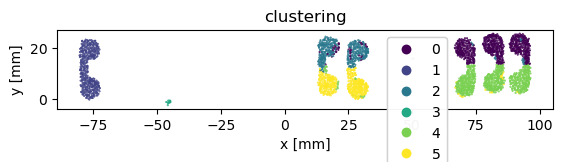

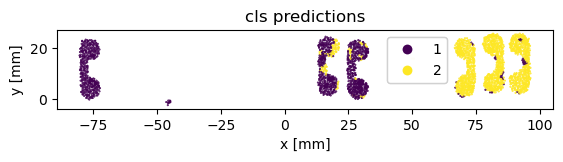

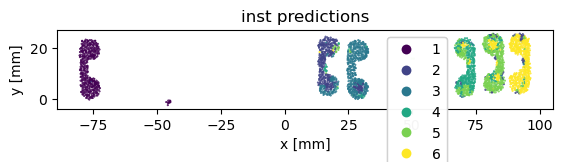

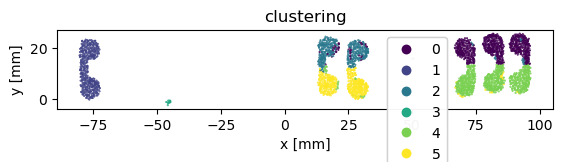

In [86]:
def plot_inference(points, values, title="", caption=""):

    fig = plt.figure()
    ax = fig.add_subplot(111)
    im = ax.scatter(points[:,0], points[:,1], s=0.25,c=values)
    ax.set_aspect(1)
    ax.set_title(title)
    ax.set_xlabel("x [mm]")
    ax.set_ylabel("y [mm]")

    legend = ax.legend(*im.legend_elements(), bbox_to_anchor=(0.8, 1), loc="upper right" )
    ax.add_artist(legend)

    ax.text(0.5, -0.25, caption, style='italic', \
        horizontalalignment='center', verticalalignment='top', transform=ax.transAxes)

    val, val_count = np.unique(values, return_counts=True)
    print(title)
    print("val")
    print(val)
    print("val_count")
    print(val_count)
    return fig

plot_inference(non_bg, cls_preds[non_bg_idx], title="cls predictions")
plot_inference(non_bg, inst_preds[non_bg_idx], title="inst predictions")
plot_inference(non_bg, clusters, title="clustering")

In [ ]:
## Visualize via plots
## Function to plot 

In [56]:
### DataSections

## 1
## x, y, scaled one-hot cls non-bg
# print(scaled_num[:, :2].shape)
# print(np.expand_dims(scaled_cat_one_hot[:, 0], axis=1).shape)
data1 = np.hstack((scaled_num[:, :2], scaled_cat_one_hot[:, :2]))
print("data1")
print(data1)
print()

## 2
## x, y, scaled cls non-bg
data2 = np.hstack((scaled_num[:, :2], np.expand_dims(scaled_cat[:, 0], axis=1)))
print("data2")
print(data2)
print()

## 3
## x, y, z, scaled one-hot cls non-bg
data3 = np.hstack((scaled_num, np.expand_dims(scaled_cat_one_hot[:, 0], axis=1)))
print("data3")
print(data3)
print()

## 4
## x, y, z, scaled cls non-bg
data4 = np.hstack((scaled_num, np.expand_dims(scaled_cat[:,0], axis=1)))
print("data4")
print(data4)
print()

## 5
## x, y, z, scaled one-hot cls non-bg, scaled one-hot inst non_bg
data5 = np.hstack((scaled_num, scaled_cat_one_hot))
print("data5")
print(data5)
print()

## 6
## x, y, z, scaled cls non-bg, scaled inst non-bg
data6 = np.hstack((scaled_num, scaled_cat))
print("data6")
print(data6)
print()

## 7
## x, scaled one-hot cls non-bg
data7 = np.hstack((np.expand_dims(scaled_num[:, 0], axis=1), scaled_cat_one_hot[:, :2]))
print("data7")
print(data7)
print()

## 8 
## x, scaled cls non-bg
data8 = np.hstack((np.expand_dims(scaled_num[:, 0], axis=1), np.expand_dims(scaled_cat[:, 0], axis=1)))
print("data8")
print(data8)
print()

## 9 
## x, scaled one-hot cls non-bg, scaled one-hot inst non-bg
data9 = np.hstack((np.expand_dims(scaled_num[:, 0], axis=1), scaled_cat_one_hot))
print("data9")
print(data9)
print()

## 10 
## x, scaled cls non-bg, scaled inst non-bg
data10 = np.hstack((np.expand_dims(scaled_num[:, 0], axis=1), scaled_cat))
print("data10")
print(data10)
print()

## 11
## x only
data11 = np.expand_dims(scaled_num[:, 0], axis=1)
print("data11")
print(data11)
print()

## 12
## x, y only
# data12 = np.expand_dims(scaled_num[:, 0], axis=1)
data12 = scaled_num[:, :2]
print("data12")
print(data12)
print()

## 13
## x, y, z only
# data13 = np.expand_dims(scaled_num[:, 0], axis=1)
data13 = scaled_num[:, :3]
print("data13")
print(data13)
print()

data_sec = [data1, data2, data3, data4, data5, data6]
data_sec_tags = ["data1", "data2", "data3", "data4", "data5", "data6"]

data_sec2 = [data7, data8, data9, data10, data11]
data_sec_tags2 = ["data7", "data8", "data9", "data10", "data11"]

data_sec3 = [data12, data13]
data_sec_tags3 = ["data11", "data12"]

data1
[[ 0.7200712  -1.12889789 -0.87557202  0.87557202]
 [ 0.75610837  0.50940801  1.1421105  -1.1421105 ]
 [ 0.50835299  0.72738007 -0.87557202  0.87557202]
 ...
 [ 0.73178331  1.7117699  -0.87557202  0.87557202]
 [ 0.92638397  1.7117699  -0.87557202  0.87557202]
 [ 0.723675    1.74692672 -0.87557202  0.87557202]]

data2
[[ 0.7200712  -1.12889789  0.87557202]
 [ 0.75610837  0.50940801 -1.1421105 ]
 [ 0.50835299  0.72738007  0.87557202]
 ...
 [ 0.73178331  1.7117699   0.87557202]
 [ 0.92638397  1.7117699   0.87557202]
 [ 0.723675    1.74692672  0.87557202]]

data3
[[ 0.7200712  -1.12889789 -0.44776672 -0.87557202]
 [ 0.75610837  0.50940801 -0.45093285  1.1421105 ]
 [ 0.50835299  0.72738007 -0.36861326 -0.87557202]
 ...
 [ 0.73178331  1.7117699  -0.39183154 -0.87557202]
 [ 0.92638397  1.7117699  -0.41434636 -0.87557202]
 [ 0.723675    1.74692672 -0.36157735 -0.87557202]]

data4
[[ 0.7200712  -1.12889789 -0.44776672  0.87557202]
 [ 0.75610837  0.50940801 -0.45093285 -1.1421105 ]
 [ 0.50

In [23]:
### Clustering Options

from sklearn.cluster import KMeans, AffinityPropagation, SpectralClustering, AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph

# ## A
# ## KMeans with inst_count clusters

# modelA = KMeans(n_clusters=cluster_count,init='k-means++', verbose=0, random_state=0)


# ## B
# ## KMeans with inst_count*3 clusters

# modelB = KMeans(n_clusters=cluster_count*3,init='k-means++', verbose=0, random_state=0)

# ## C
# ## Affinity Propogation
# modelC = AffinityPropagation( random_state=0)

# ## D
# ## Spectural Clustering with inst_count cluster
# modelD = SpectralClustering(n_clusters=cluster_count, random_state=0)


# ## E
# ## Spectural Clustering with inst_count*3 cluster
# modelE = SpectralClustering(n_clusters=cluster_count*3, random_state=0)


# ## F
# ## Heirarchical Clustering: Agglomerative Clustering w/ single linkage and connectivty constraint
# data = data1
# knn_graph = kneighbors_graph(data, 30, include_self=False)
# modelF1 = AgglomerativeClustering(linkage='single', connectivity=knn_graph, n_clusters=cluster_count)
# modelF2 = AgglomerativeClustering(linkage='single', connectivity=None, n_clusters=cluster_count)
# modelF3 = AgglomerativeClustering(linkage='single', connectivity=knn_graph, n_clusters=cluster_count*3)
# modelF4 = AgglomerativeClustering(linkage='single', connectivity=None, n_clusters=cluster_count*3)


# ## G
# ## Heirarchical Clustering: Agglomerative Clustering w/ ward linkage and connectivty constraint
# modelG1 = AgglomerativeClustering(linkage='ward', connectivity=knn_graph, n_clusters=cluster_count)
# modelG2 = AgglomerativeClustering(linkage='ward', connectivity=None, n_clusters=cluster_count)
# modelG3 = AgglomerativeClustering(linkage='ward', connectivity=knn_graph, n_clusters=cluster_count*3)
# modelG4 = AgglomerativeClustering(linkage='ward', connectivity=None, n_clusters=cluster_count*3)


# ## H
# ## Heirarchical Clustering: Agglomerative Clustering w/ complete linkage and connectivty constraint
# modelH1 = AgglomerativeClustering(linkage='complete', connectivity=knn_graph, n_clusters=cluster_count)
# modelH2 = AgglomerativeClustering(linkage='complete', connectivity=None, n_clusters=cluster_count)
# modelH3 = AgglomerativeClustering(linkage='complete', connectivity=knn_graph, n_clusters=cluster_count*3)
# modelH4 = AgglomerativeClustering(linkage='complete', connectivity=None, n_clusters=cluster_count*3)

# ## I
# ## Heirarchical Clustering: Agglomerative Clustering w/ average linkage and connectivty constraint
# modelI1 = AgglomerativeClustering(linkage='average', connectivity=knn_graph, n_clusters=cluster_count)
# modelI2 = AgglomerativeClustering(linkage='average', connectivity=None, n_clusters=cluster_count)
# modelI3 = AgglomerativeClustering(linkage='average', connectivity=knn_graph, n_clusters=cluster_count*3)
# modelI4 = AgglomerativeClustering(linkage='average', connectivity=None, n_clusters=cluster_count*3)

# ## 
# ## DBSCAN

# ## 
# ## OPTICS

# ## 
# ## BIRCH

# models = [modelA, modelB, modelC, modelD, modelE, modelF1, modelF2, modelF3, modelF4, modelG1, modelG2, modelG3, modelG4, \
#           modelH1, modelH2, modelH3, modelH4, modelI1, modelI2, modelI3, modelI4]
# model_tags = ["modelA", "modelB", "modelC", "modelD", "modelE", "modelF1", "modelF2", "modelF3", "modelF4", \
#               "modelG1", "modelG2", "modelG3", "modelG4", "modelH1", "modelH2", "modelH3", "modelH4", \
#               "modelI1", "modelI2", "modelI3", "modelI4"]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data1, modelA
val
[0 1 2 3 4 5]
val_count
[797 230 857 474 366 198]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data1, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[241  63 243 322 182 154  80 205 184  29 130 160 293 215  81  28 301  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning: Affinity propagation did not converge, this model may return degenerate cluster centers and labels.
  warnings.warn(


data1, modelC
val
[   0    1    2 ... 1825 1826 1827]
val_count
[1 1 1 ... 1 1 1]
data1, modelD
val
[0 1 2 3 4 5]
val_count
[788 236 192 478 866 362]
data1, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[130 585   8  55 115  70 661  18 120  23  79 209  11  34 178 274 295  57]
data1, modelF1
val
[0 1 2 3 4 5]
val_count
[  41 1654   11   11  788  417]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelF2
val
[0 1 2 3 4 5]
val_count
[  41 1654   11   11  788  417]
data1, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18    6    8    4   80   11   20    3   10  788    1    2  417    1
 1538    6    1    8]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18    6    8    4   80   11   20    6    3  788    1  417 1538    2
   10    1    1    8]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelG1
val
[0 1 2 3 4 5]
val_count
[841 382 813 214 458 214]
data1, modelG2
val
[0 1 2 3 4 5]
val_count
[841 382 813 214 458 214]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[319 386  34 345 107  29 193  82  23 137 257 357 150 107  78 136 116  66]
data1, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[319 386  34 345 107  29 193  82  23 137 257 357 150 107  78 136 116  66]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelH1
val
[0 1 2 3 4 5]
val_count
[ 798 1654   13   18  428   11]
data1, modelH2
val
[0 1 2 3 4 5]
val_count
[274 837 542 154 817 298]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[1613   10    3   14   11  417  788    4   12    6    3    6    4    8
    4    4    8    7]
data1, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[287 629  28 463  82 310  81 154  13 174  11  14 141  72  52 272  20 119]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelI1
val
[0 1 2 3 4 5]
val_count
[  23 1654  428   11  788   18]
data1, modelI2
val
[0 1 2 3 4 5]
val_count
[ 366  474 1027  209  627  219]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data1, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18   80    2    6  788    6 1538  417   20   11    6   10    2    8
    3    2    1    4]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


data1, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 14 451 286 166 639  80 198  11  13 613  18  20 194  11  53  10   2 143]


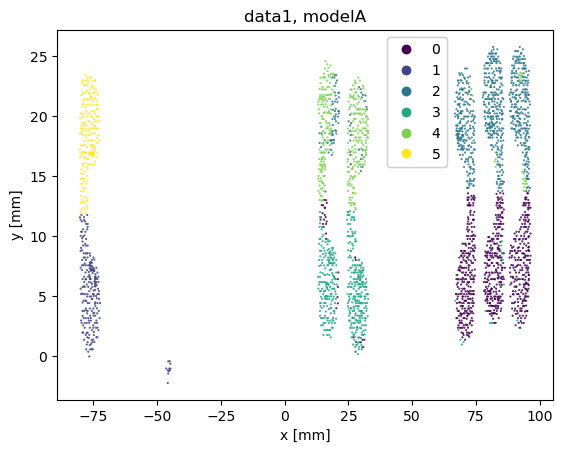

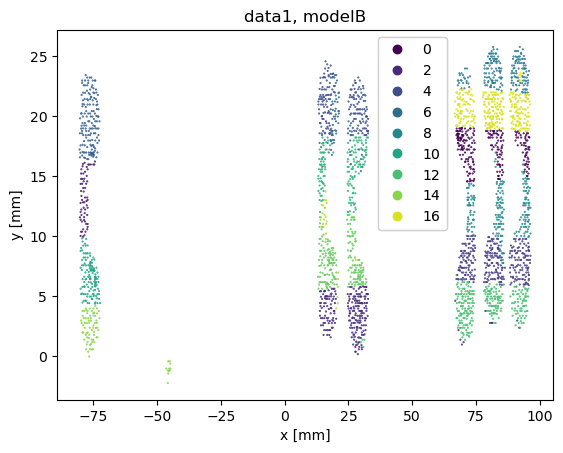

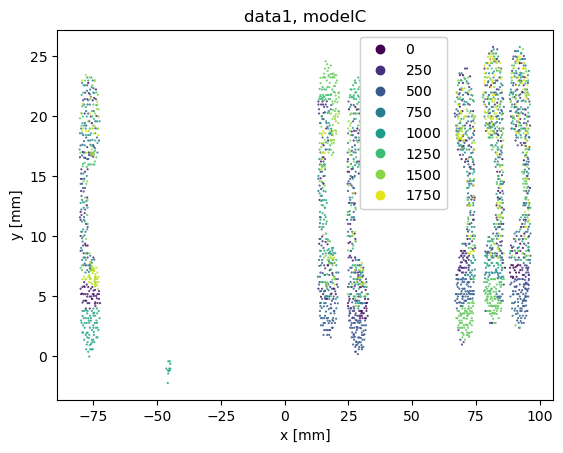

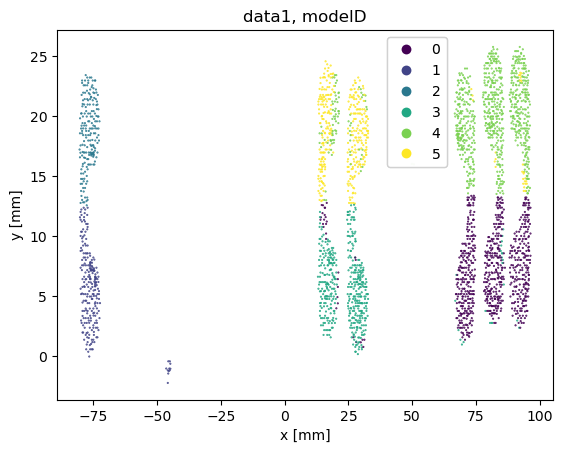

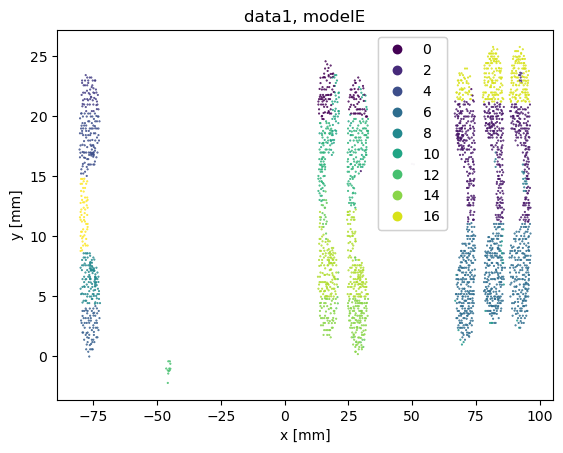

...

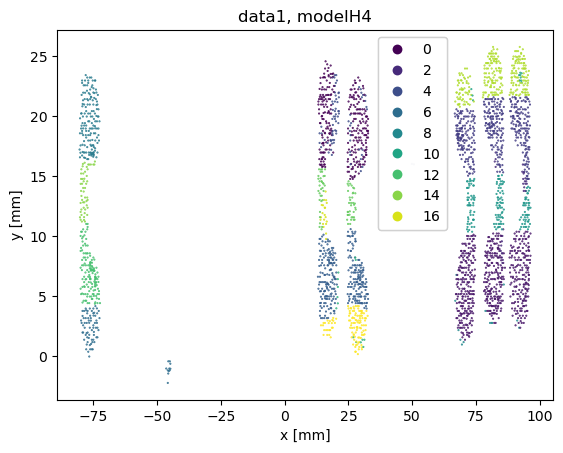

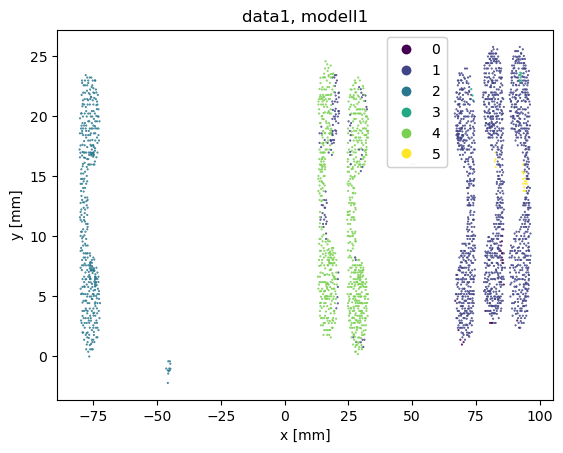

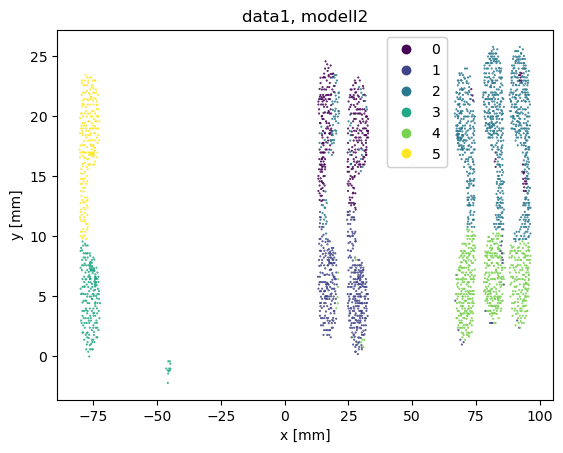

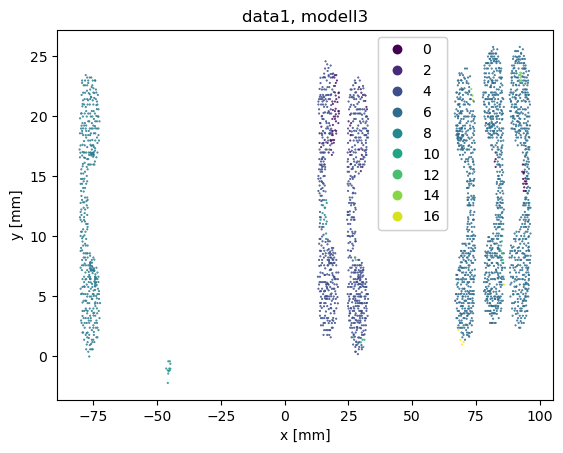

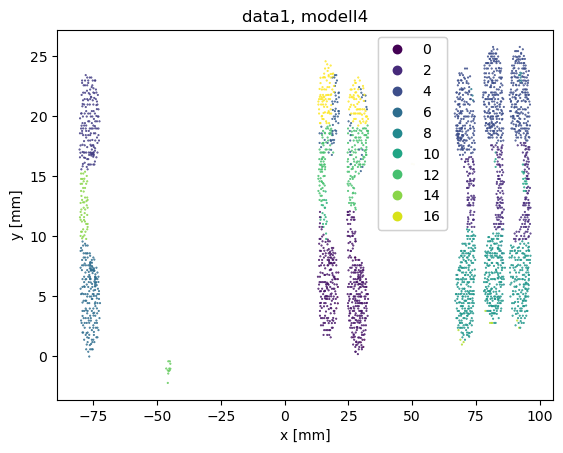

In [33]:
def run_all_models(data, data_tag):

    ## A
    ## KMeans with inst_count clusters
    modelA = KMeans(n_clusters=cluster_count,init='k-means++', verbose=0, random_state=0)


    ## B
    ## KMeans with inst_count*3 clusters
    modelB = KMeans(n_clusters=cluster_count*3,init='k-means++', verbose=0, random_state=0)

    ## C
    ## Affinity Propogation
    modelC = AffinityPropagation(random_state=0, preference=300)

    ## D
    ## Spectural Clustering with inst_count cluster
    modelD = SpectralClustering(n_clusters=cluster_count, random_state=0)


    ## E
    ## Spectural Clustering with inst_count*3 cluster
    modelE = SpectralClustering(n_clusters=cluster_count*3, random_state=0)


    ## F
    ## Heirarchical Clustering: Agglomerative Clustering w/ single linkage and connectivty constraint
    knn_graph = kneighbors_graph(data, 30, include_self=False)
    modelF1 = AgglomerativeClustering(linkage='single', connectivity=knn_graph, n_clusters=cluster_count)
    modelF2 = AgglomerativeClustering(linkage='single', connectivity=None, n_clusters=cluster_count)
    modelF3 = AgglomerativeClustering(linkage='single', connectivity=knn_graph, n_clusters=cluster_count*3)
    modelF4 = AgglomerativeClustering(linkage='single', connectivity=None, n_clusters=cluster_count*3)


    ## G
    ## Heirarchical Clustering: Agglomerative Clustering w/ ward linkage and connectivty constraint
    modelG1 = AgglomerativeClustering(linkage='ward', connectivity=knn_graph, n_clusters=cluster_count)
    modelG2 = AgglomerativeClustering(linkage='ward', connectivity=None, n_clusters=cluster_count)
    modelG3 = AgglomerativeClustering(linkage='ward', connectivity=knn_graph, n_clusters=cluster_count*3)
    modelG4 = AgglomerativeClustering(linkage='ward', connectivity=None, n_clusters=cluster_count*3)


    ## H
    ## Heirarchical Clustering: Agglomerative Clustering w/ complete linkage and connectivty constraint
    modelH1 = AgglomerativeClustering(linkage='complete', connectivity=knn_graph, n_clusters=cluster_count)
    modelH2 = AgglomerativeClustering(linkage='complete', connectivity=None, n_clusters=cluster_count)
    modelH3 = AgglomerativeClustering(linkage='complete', connectivity=knn_graph, n_clusters=cluster_count*3)
    modelH4 = AgglomerativeClustering(linkage='complete', connectivity=None, n_clusters=cluster_count*3)

    ## I
    ## Heirarchical Clustering: Agglomerative Clustering w/ average linkage and connectivty constraint
    modelI1 = AgglomerativeClustering(linkage='average', connectivity=knn_graph, n_clusters=cluster_count)
    modelI2 = AgglomerativeClustering(linkage='average', connectivity=None, n_clusters=cluster_count)
    modelI3 = AgglomerativeClustering(linkage='average', connectivity=knn_graph, n_clusters=cluster_count*3)
    modelI4 = AgglomerativeClustering(linkage='average', connectivity=None, n_clusters=cluster_count*3)

    ## 
    ## DBSCAN

    ## 
    ## OPTICS

    ## 
    ## BIRCH

    models = [modelA, modelB, modelC, modelD, modelE, modelF1, modelF2, modelF3, modelF4,\
              modelG1, modelG2, modelG3, modelG4, modelH1, modelH2, modelH3, modelH4, \
              modelI1, modelI2, modelI3, modelI4]
    model_tags = ["modelA", "modelB", "modelC", "modelD", "modelE", "modelF1", "modelF2", "modelF3", "modelF4", \
                 "modelG1", "modelG2", "modelG3", "modelG4", "modelH1", "modelH2", "modelH3", "modelH4", \
                 "modelI1", "modelI2", "modelI3", "modelI4"]
    
    for idx, model in enumerate(models):
        clusters = model.fit(data).labels_
        plot_inference(non_bg, clusters, title=f"{data_tag}, {model_tags[idx]}")


run_all_models(data1, "data1")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data2, modelA
val
[0 1 2 3 4 5]
val_count
[797 230 857 474 366 198]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data2, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[241  63 243 322 182 154  80 205 184  29 130 160 293 215  81  28 301  11]
data2, modelC
val
[   0    1    2 ... 2919 2920 2921]
val_count
[1 1 1 ... 1 1 1]
data2, modelD
val
[0 1 2 3 4 5]
val_count
[788 236 192 478 866 362]
data2, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[130 585   8  55 115  70 661  18 120  23  79 209  11  34 178 274 295  57]
data2, modelF1
val
[0 1 2 3 4 5]
val_count
[  41 1654  788   11   11  417]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelF2
val
[0 1 2 3 4 5]
val_count
[  41 1654   11   11  788  417]
data2, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18   80    8    4   11   20    6    3   10    1 1538    2  417    1
  788    6    1    8]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18    6    8    4   80   11   20    6    3  788    1  417 1538    2
   10    1    1    8]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelG1
val
[0 1 2 3 4 5]
val_count
[841 382 813 214 458 214]
data2, modelG2
val
[0 1 2 3 4 5]
val_count
[841 382 813 214 458 214]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[319 386  34 345 107  29 193  82  23 137 257 357 150 107  78 136 116  66]
data2, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[319 386  34 345 107  29 193  82  23 137 257 357 150 107  78 136 116  66]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelH1
val
[0 1 2 3 4 5]
val_count
[ 798 1654   13   18  428   11]
data2, modelH2
val
[0 1 2 3 4 5]
val_count
[274 837 542 154 817 298]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[1613   10    3   14   11  417  788    4   12    6    3    6    4    8
    4    4    8    7]
data2, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[287 629  28 463  82 310  81 154  13 174  11  14 141  72  52 272  20 119]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelI1
val
[0 1 2 3 4 5]
val_count
[  23 1654  428   11  788   18]
data2, modelI2
val
[0 1 2 3 4 5]
val_count
[ 366  474 1027  209  627  219]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 3 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data2, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  18   80    2    6  788    6 1538  417   20   11    6   10    2    8
    3    2    1    4]
data2, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 14 451 286 166 639  80 198  11  13 613  18  20 194  11  53  10   2 143]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


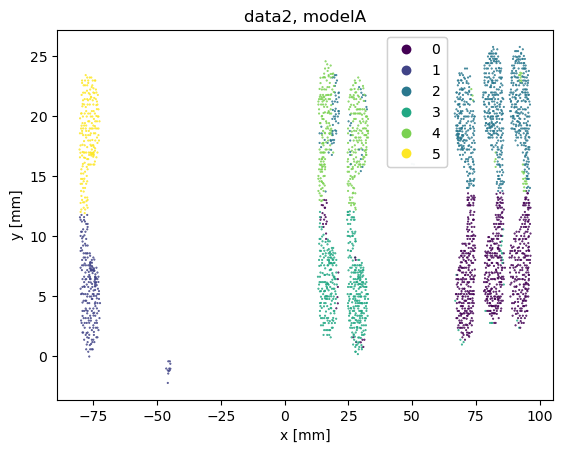

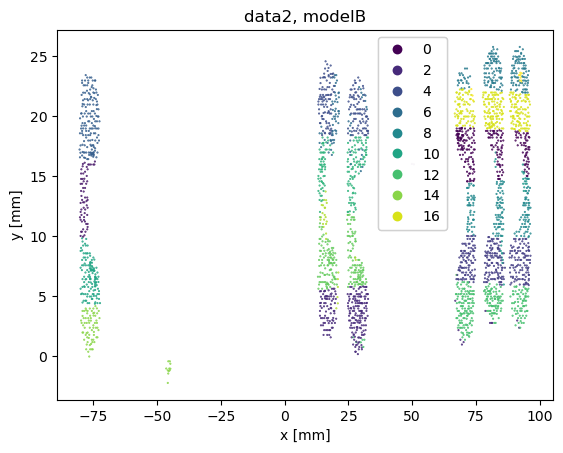

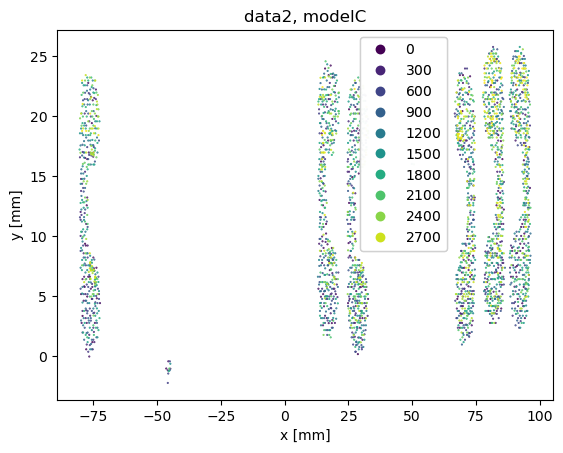

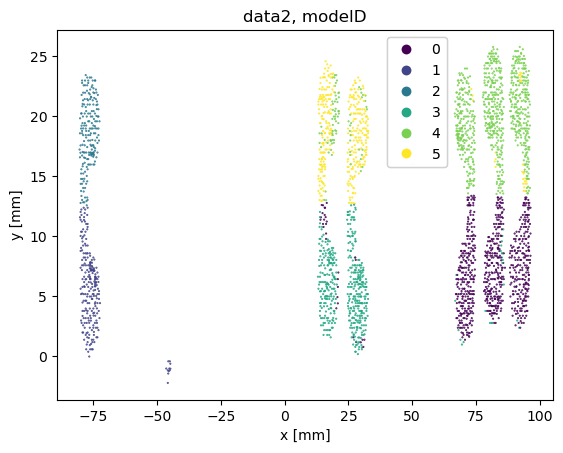

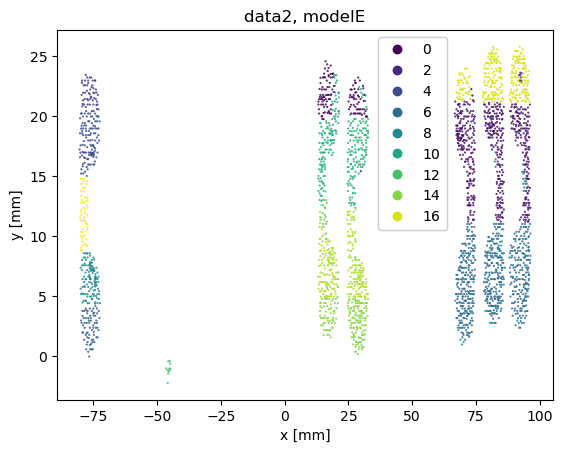

...

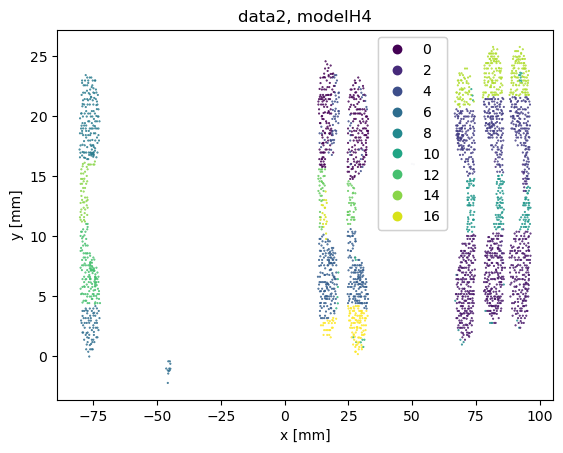

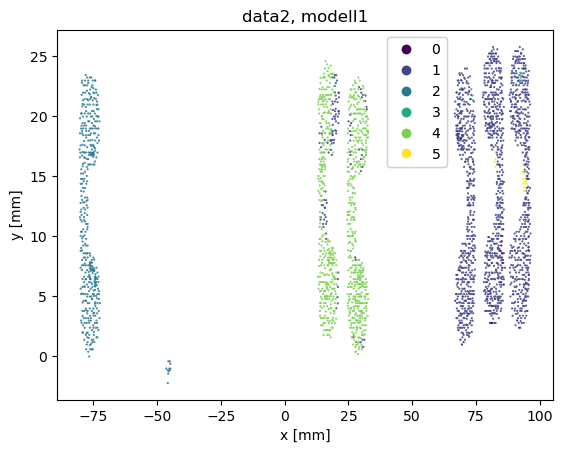

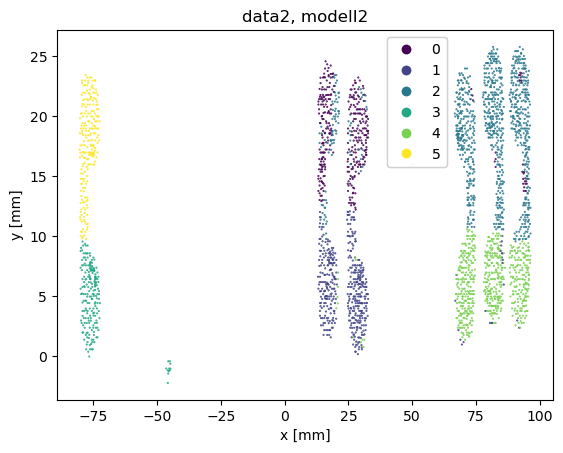

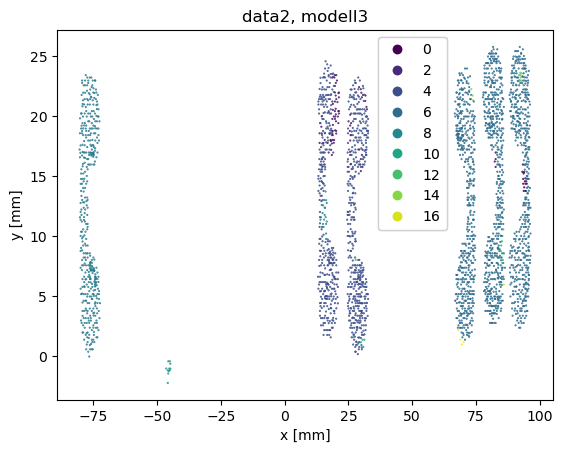

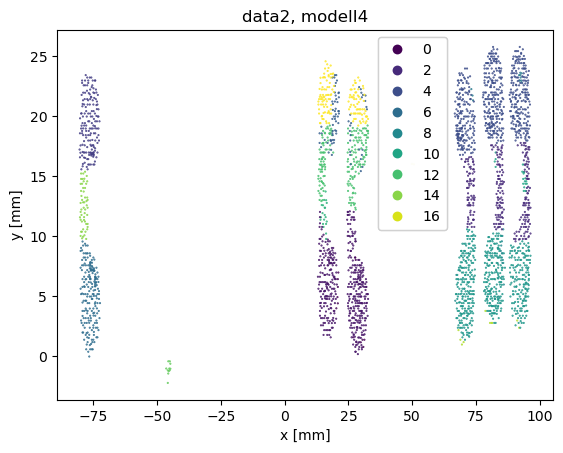

In [26]:
run_all_models(data2, "data2")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data3, modelA
val
[0 1 2 3 4 5]
val_count
[799 474 855  11 366 417]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data3, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[194 302  11 340 137 196 178  28 188 323 243 155  80  29  93 300 102  23]
data3, modelC
val
[   0    1    2 ... 2919 2920 2921]
val_count
[1 1 1 ... 1 1 1]
data3, modelD
val
[0 1 2 3 4 5]
val_count
[864  11 362 790 417 478]
data3, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 78  11 967  23  92  74  18   8 128   6 130 584 115 204 215   2  28 239]
data3, modelF1
val
[0 1 2 3 4 5]
val_count
[1654  417   41   11  788   11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelF2
val
[0 1 2 3 4 5]
val_count
[1654  417   41   11  788   11]
data3, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  11  416    3   11   17    3   80    8 1535  788    8    1   11    1
    2   20    6    1]
data3, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  11  416    3   11  788   17   80    8    2    3    6    1    8    1
 1535   11   20    1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(
C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelG1
val
[0 1 2 3 4 5]
val_count
[417 909 479 745 361  11]
data3, modelG2
val
[0 1 2 3 4 5]
val_count
[417 909 479 745 361  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[195 280 179  34 334  29 108 277 212 411  80  11 264 114 120  23  84 167]
data3, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[195 280 179  34 334  29 108 277 212 411  80  11 264 114 120  23  84 167]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelH1
val
[0 1 2 3 4 5]
val_count
[ 840 1651    4  413    3   11]
data3, modelH2
val
[0 1 2 3 4 5]
val_count
[777 916 466  11 240 512]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[1600  401   20    8  779   11    9   17   18   10    3   11    6    3
    4    9   10    3]
data3, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[335 353 159  28 190 164 576  14 263  13 177 529  11  13  63  11  20   3]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelI1
val
[0 1 2 3 4 5]
val_count
[ 829  417   11 1651    3   11]
data3, modelI2
val
[0 1 2 3 4 5]
val_count
[417 774 337  11 503 880]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data3, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 788 1617   11    8    3   20    4   17  405    3   10   11    1    6
    3    1   10    4]
data3, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[846 461 174 308  23  14  18  48   3 187  80 674   8  20  11  11  19  17]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


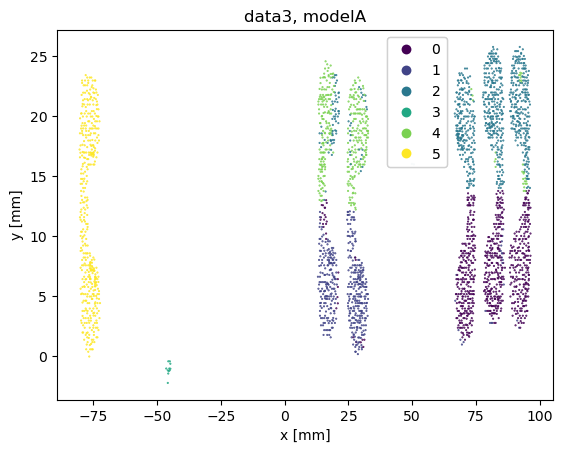

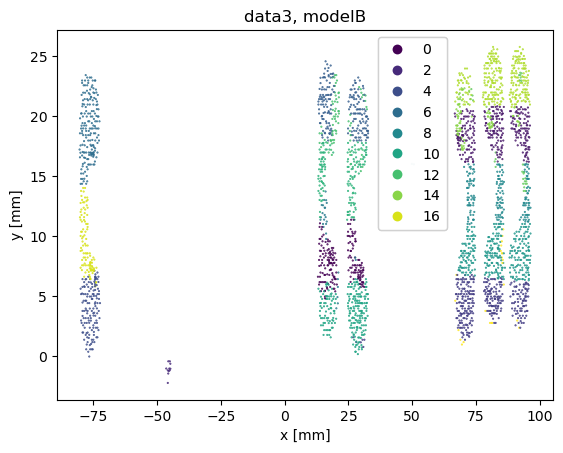

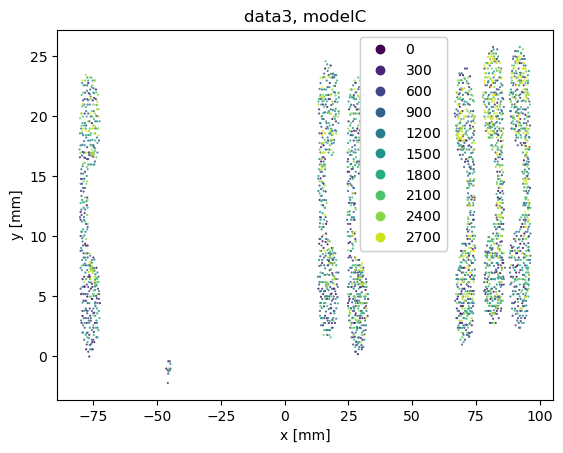

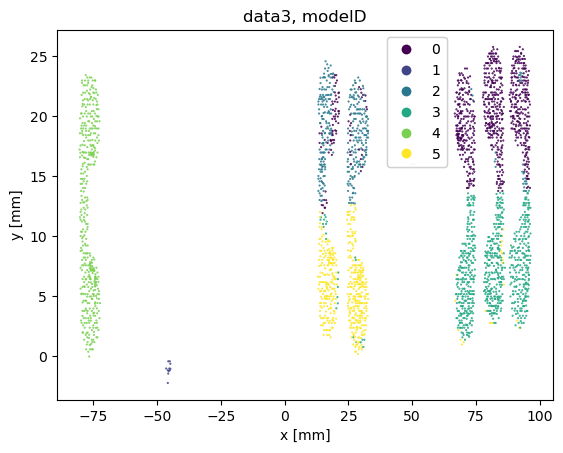

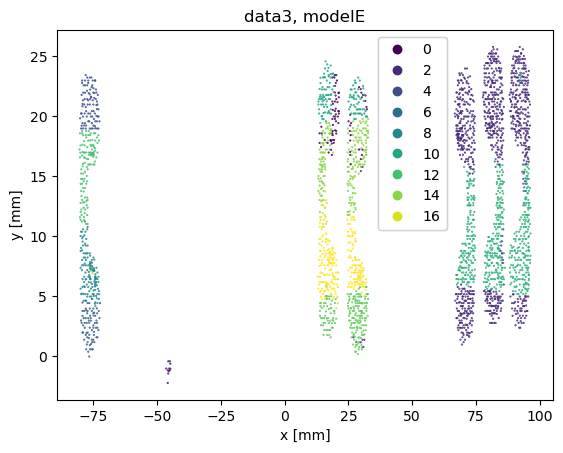

...

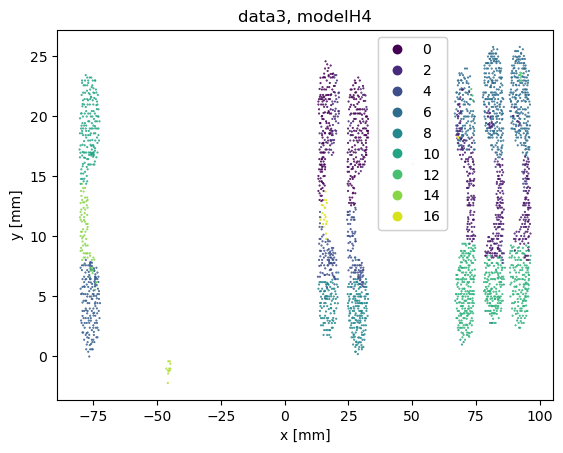

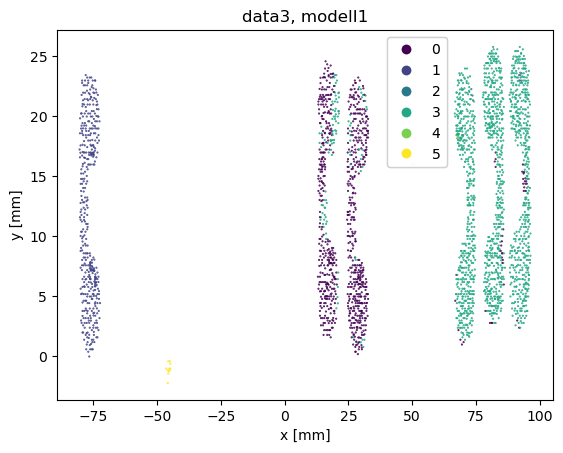

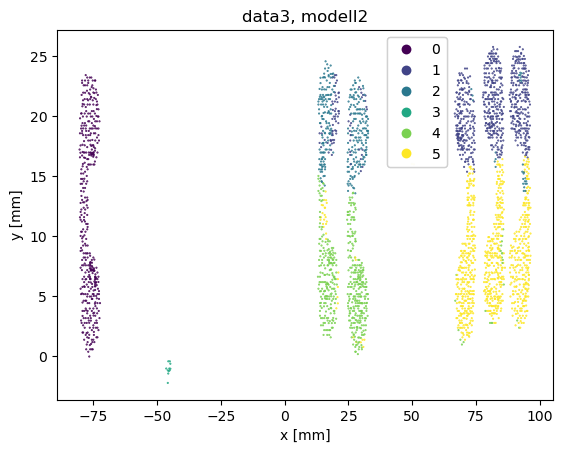

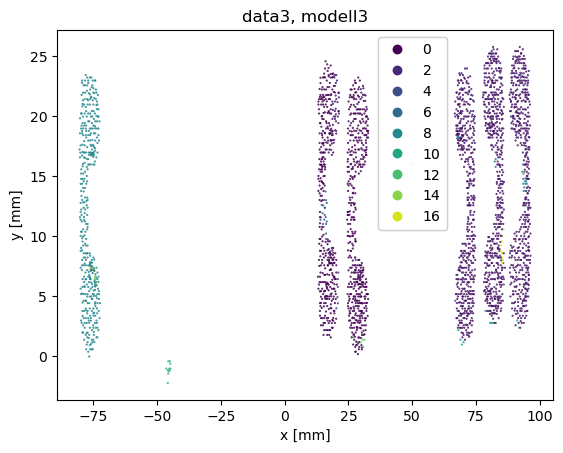

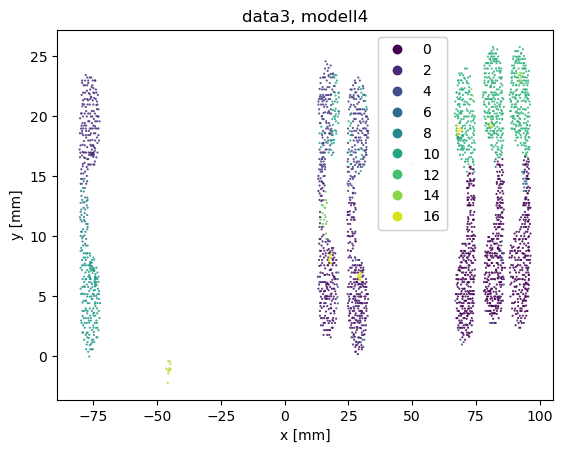

In [27]:
run_all_models(data3, "data3")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data4, modelA
val
[0 1 2 3 4 5]
val_count
[799 474 855  11 366 417]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data4, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[194 302  11 340 137 196 178  28 188 323 243 155  80  29  93 300 102  23]
data4, modelC
val
[   0    1    2 ... 2919 2920 2921]
val_count
[1 1 1 ... 1 1 1]
data4, modelD
val
[0 1 2 3 4 5]
val_count
[864  11 362 790 417 478]
data4, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 78  11 967  23  92  74  18   8 128   6 130 584 115 204 215   2  28 239]
data4, modelF1
val
[0 1 2 3 4 5]
val_count
[1654  417   41   11  788   11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelF2
val
[0 1 2 3 4 5]
val_count
[1654  417   41   11  788   11]
data4, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  11  416    3   11   17    3   80    8 1535  788    8    1   11    1
    2   20    6    1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  11  416    3   11  788   17   80    8    2    3    6    1    8    1
 1535   11   20    1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelG1
val
[0 1 2 3 4 5]
val_count
[417 909 479 745 361  11]
data4, modelG2
val
[0 1 2 3 4 5]
val_count
[417 909 479 745 361  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[195 280 179  34 334  29 108 277 212 411  80  11 264 114 120  23  84 167]
data4, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[195 280 179  34 334  29 108 277 212 411  80  11 264 114 120  23  84 167]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelH1
val
[0 1 2 3 4 5]
val_count
[ 840 1651    4  413    3   11]
data4, modelH2
val
[0 1 2 3 4 5]
val_count
[777 916 466  11 240 512]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[1600  401   20    8  779   11    9   17   18   10    3   11    6    3
    4    9   10    3]
data4, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[335 353 159  28 190 164 576  14 263  13 177 529  11  13  63  11  20   3]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelI1
val
[0 1 2 3 4 5]
val_count
[ 829  417   11 1651    3   11]
data4, modelI2
val
[0 1 2 3 4 5]
val_count
[417 774 337  11 503 880]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data4, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 788 1617   11    8    3   20    4   17  405    3   10   11    1    6
    3    1   10    4]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


data4, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[846 461 174 308  23  14  18  48   3 187  80 674   8  20  11  11  19  17]


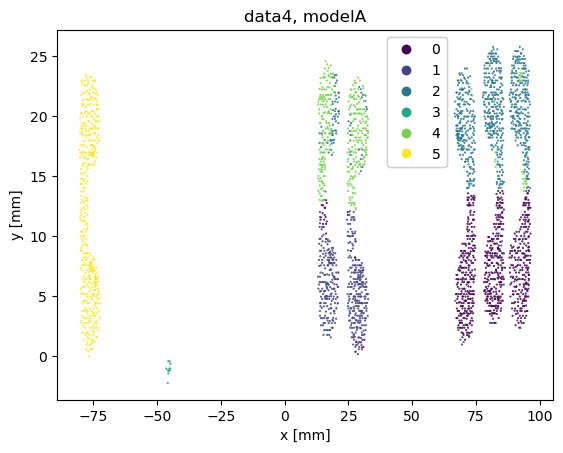

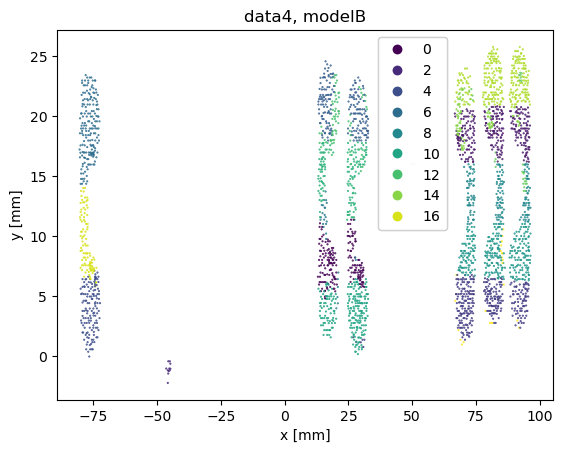

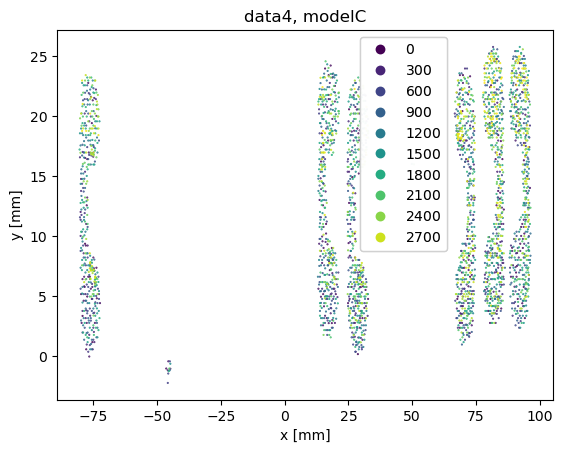

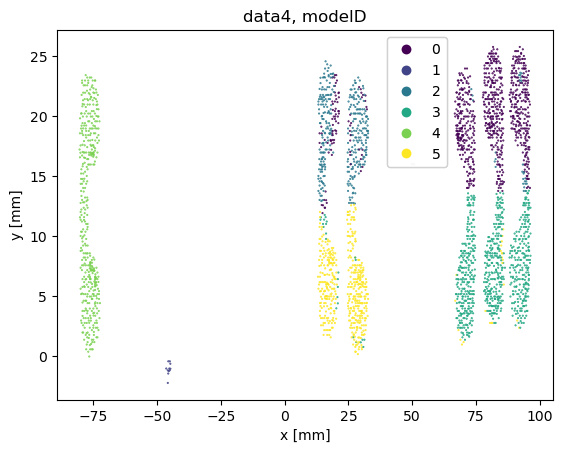

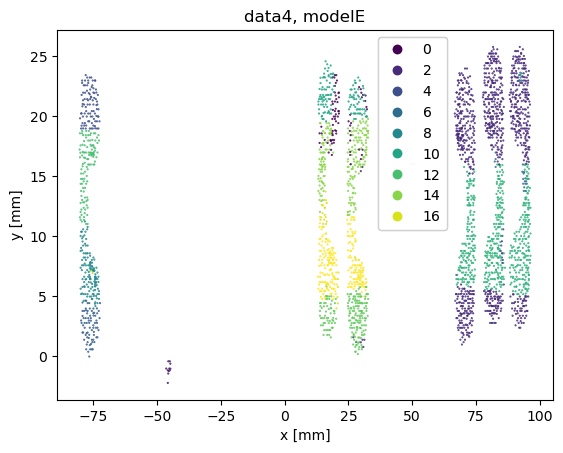

...

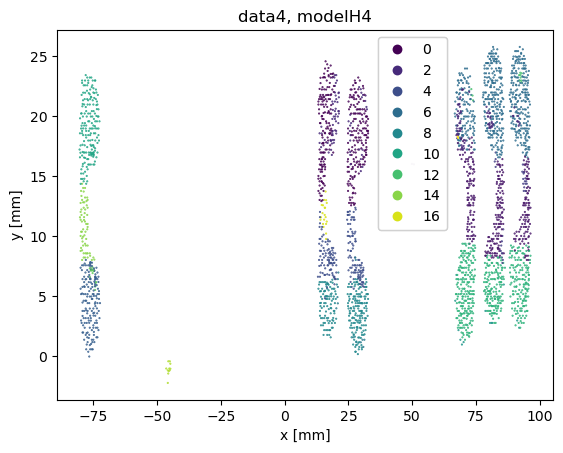

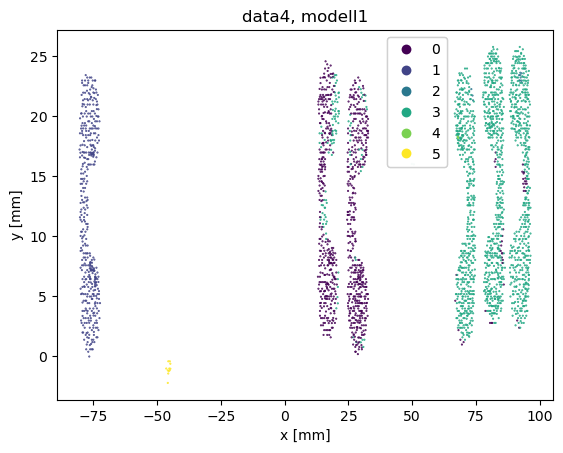

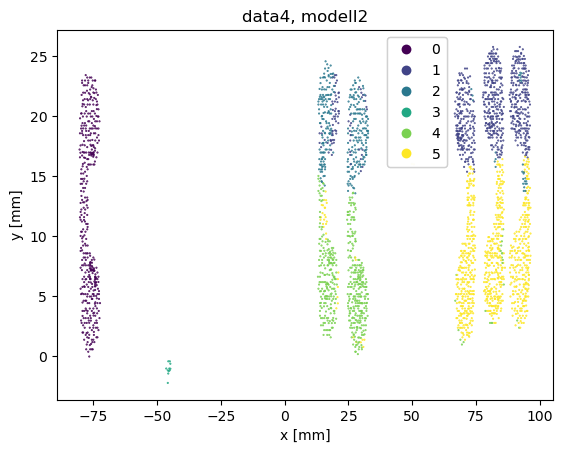

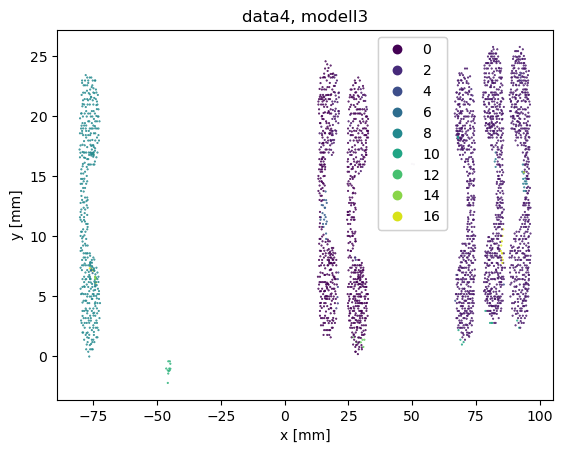

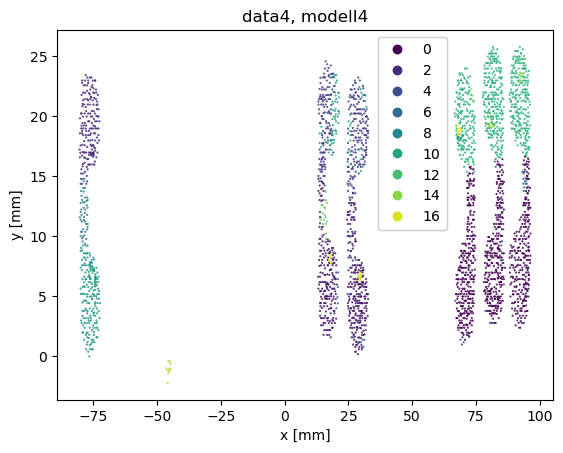

In [28]:
run_all_models(data4, "data4")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data5, modelA
val
[0 1 2 3 4 5]
val_count
[527 596 583 416 398 402]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data5, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[163 133 140 220  11 315 156 196 242 257 178 179  48 167 229 234  30  24]
data5, modelC
val
[   0    1    2 ... 2919 2920 2921]
val_count
[1 1 1 ... 1 1 1]
data5, modelD
val
[0 1 2 3 4 5]
val_count
[1168   11  402  416  398  527]
data5, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[263   3   4   7  11  30  40   8  24 330 565 167 163 394 190 194 222 307]
data5, modelF1
val
[0 1 2 3 4 5]
val_count
[994 402 416 527 572  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelF2
val
[0 1 2 3 4 5]
val_count
[1168  398  527   11  402  416]
data5, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 30  64 329 394   3   8 416 561   5 593 497  11   1   1   2   3   3   1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 30  64 329 593   3 416   8 561 394   5 497   3   1   1   2  11   3   1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelG1
val
[0 1 2 3 4 5]
val_count
[583 402 527 416 596 398]
data5, modelG2
val
[0 1 2 3 4 5]
val_count
[583 402 416 596 527 398]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[329  72 222 288 187 211 153 168 305 260  26 194 232  11  30 151  76   7]
data5, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[329  72 222 288 187 211 153  26 305 260 232 194 168  11  30 151  76   7]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelH1
val
[0 1 2 3 4 5]
val_count
[994 527 402 572 416  11]
data5, modelH2
val
[0 1 2 3 4 5]
val_count
[1168  398  417   11  527  401]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[565 497   3  14   7  40 315 593 394   3 416  11   8   1   5  22   4  24]
data5, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[497 364 565 167 255  30  64   3 177   4 229 239   7 139 162   1   8  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelI1
val
[0 1 2 3 4 5]
val_count
[994 527 572 402 416  11]
data5, modelI2
val
[0 1 2 3 4 5]
val_count
[1168  527  398   11  416  402]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data5, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 64 564 593 315   7   5  24   4   3 416 497  11   1   8 394   1  14   1]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


data5, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[497 167  64 564  30 394 242 162   4   3 288   7   1   8   1  11 305 174]


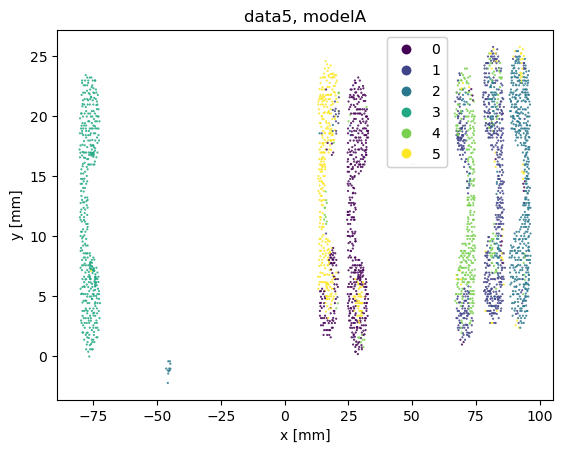

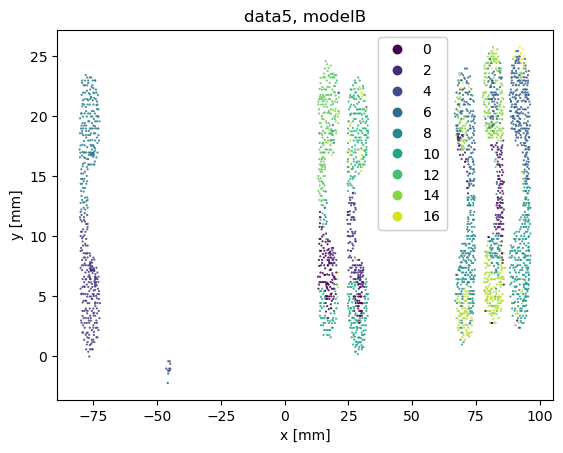

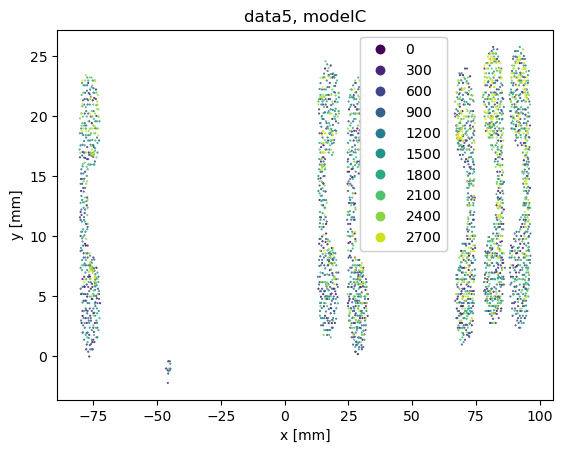

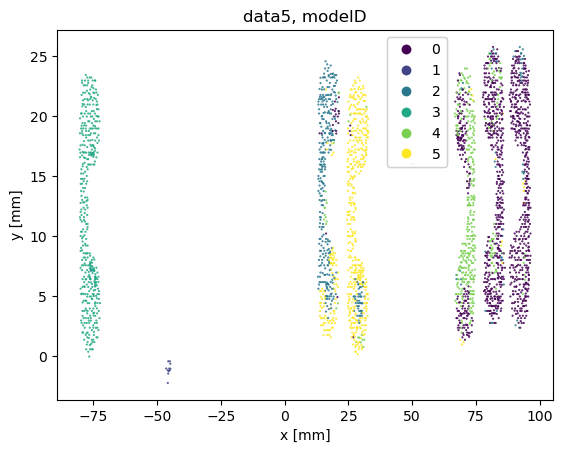

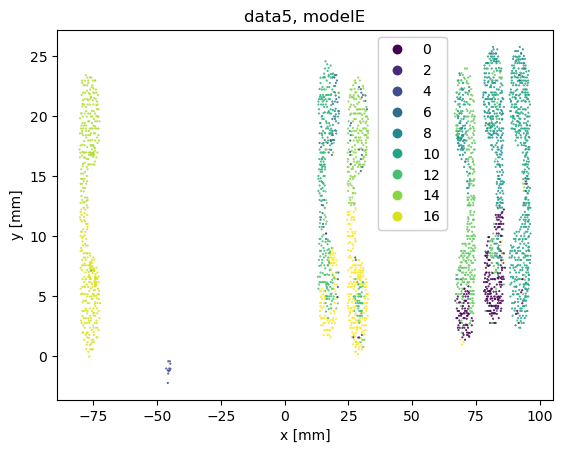

...

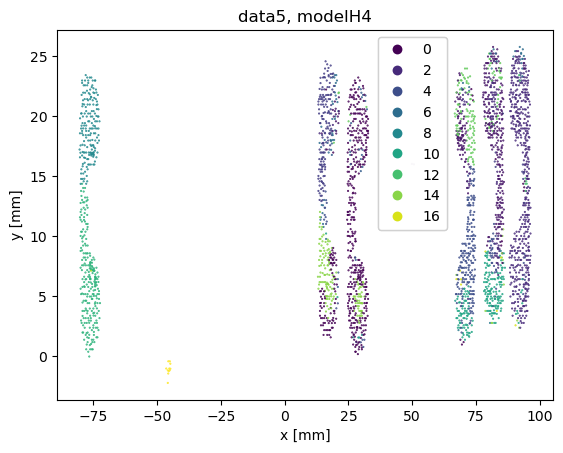

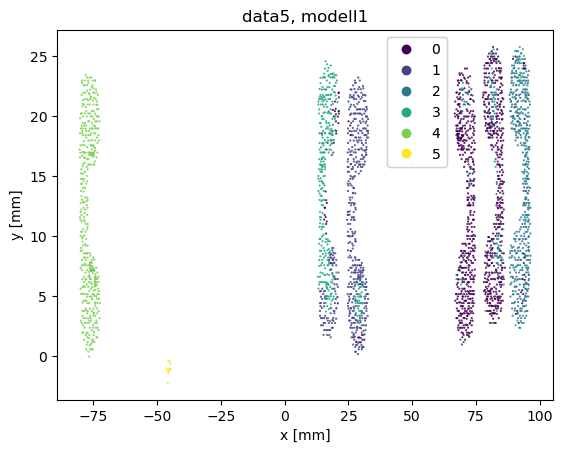

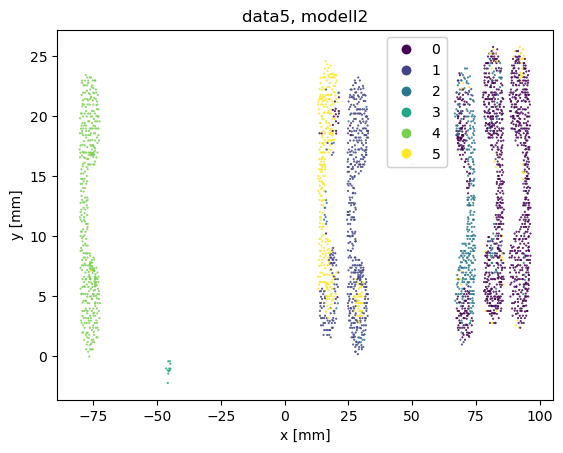

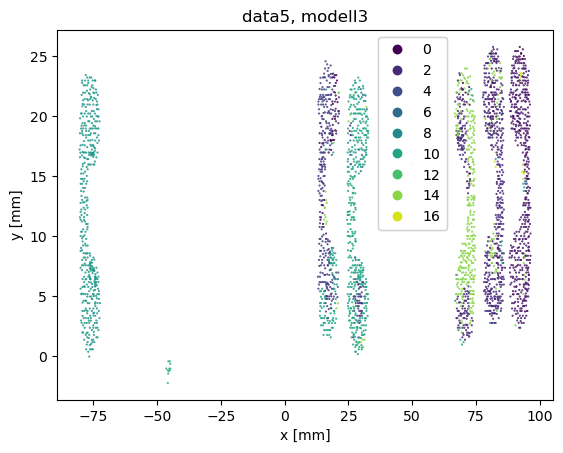

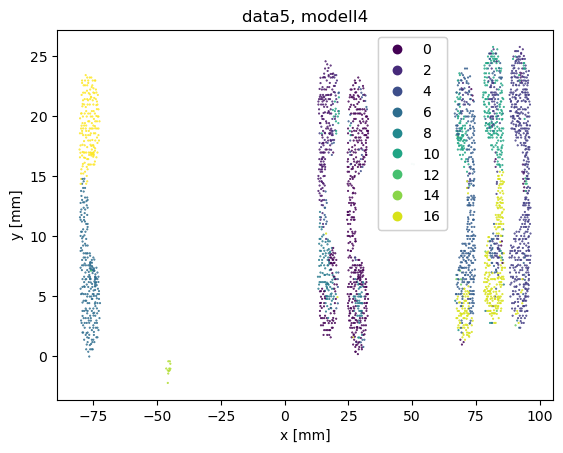

In [29]:
run_all_models(data5, "data5")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data6, modelA
val
[0 1 2 3 4 5]
val_count
[834 477 787 417 396  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data6, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[207 148 368  11 116 201 206 181 274 169  59  26 120 184  62 275 285  30]
data6, modelC
val
[   0    1    2 ... 2919 2920 2921]
val_count
[1 1 1 ... 1 1 1]
data6, modelD
val
[0 1 2 3 4 5]
val_count
[882  11 417 779 478 355]
data6, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[798  11   5  19  23   9  31 480 152 224 140  18 185   2  33 131 536 125]
data6, modelF1
val
[0 1 2 3 4 5]
val_count
[ 833  417 1654   11    2    5]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelF2
val
[0 1 2 3 4 5]
val_count
[ 833  417 1654   11    2    5]
data6, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  14   29 1530  100  417    3    1  788    8    2    2    5    6    1
    1    3   11    1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  14  417   29  100    6    3    8   11 1530    2    1    5    1    1
    2    3    1  788]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelG1
val
[0 1 2 3 4 5]
val_count
[840 417 260 832 562  11]
data6, modelG2
val
[0 1 2 3 4 5]
val_count
[417 832 493 347 822  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[421  84 260 153  29 108 181 165 195 162 301  11  76  26 260 226 114 150]
data6, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[318 260 181 271 196  29 195 255 108  84 129  11 162 226  26 207 114 150]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelH1
val
[0 1 2 3 4 5]
val_count
[1654  417  829   11    7    4]
data6, modelH2
val
[0 1 2 3 4 5]
val_count
[ 476 1003  417   11  466  549]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  23    8 1568  788   11    4   11   21    8    5    2   13  413    3
   20   11    9    4]
data6, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[415  23 661  25 236 299 134  22 177 345   7 443   3  59   4  11  33  25]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelI1
val
[0 1 2 3 4 5]
val_count
[1654    7  829   11  417    4]
data6, modelI2
val
[0 1 2 3 4 5]
val_count
[1545  417  833   11    7  109]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 2 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data6, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[1589    8    4  409    8    9   14  788    9    8   20    5   11   13
    3    2   11   11]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


data6, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[243   7  30 436  25  22 801  19 694  25 174   4   3 352   9  11  59   8]


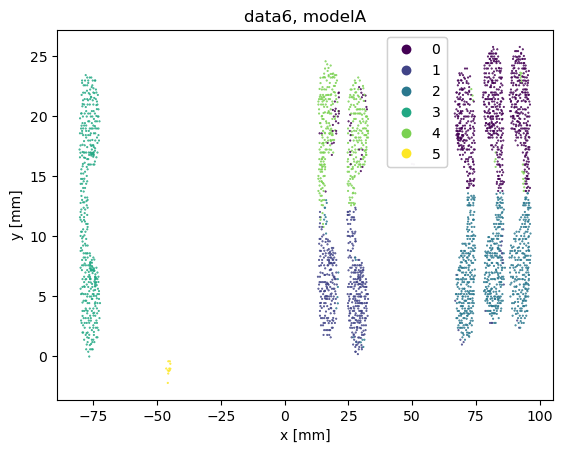

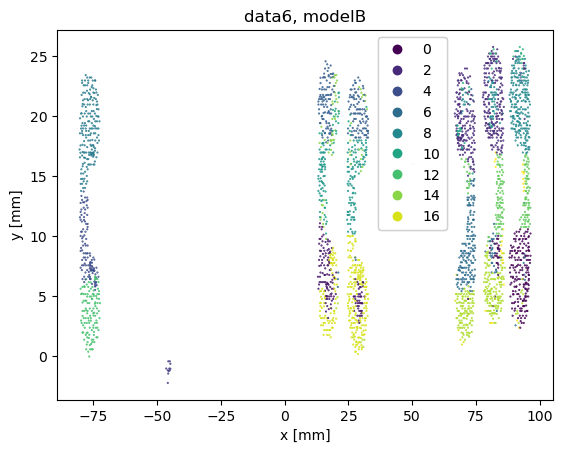

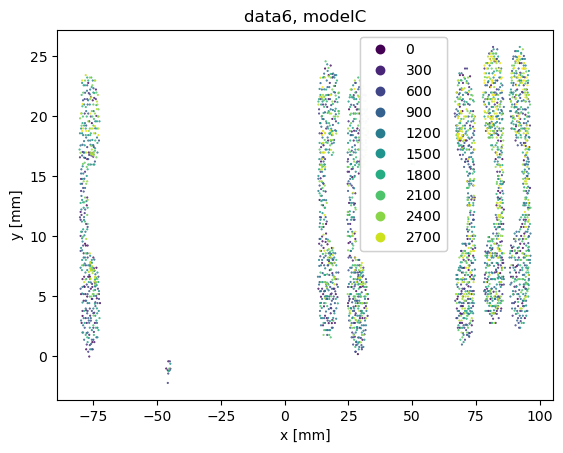

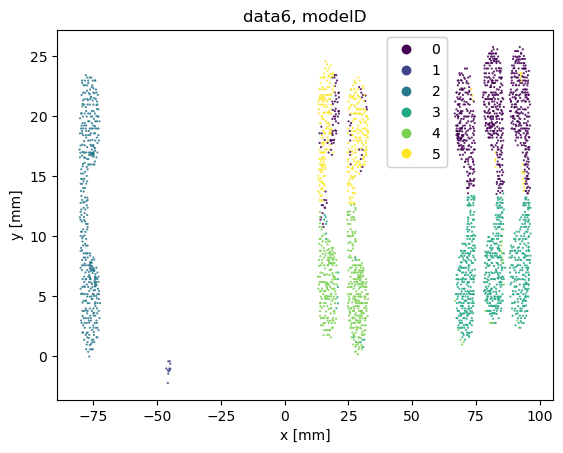

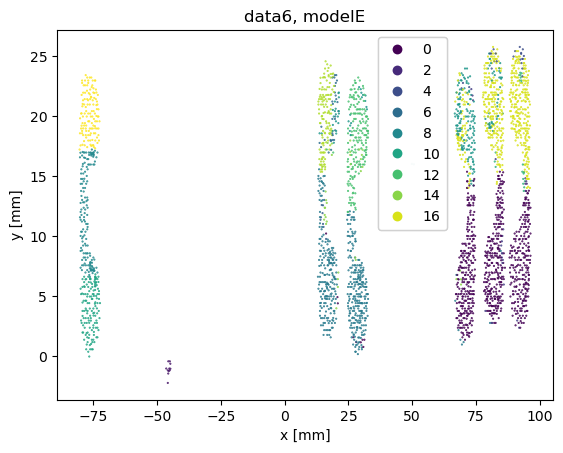

...

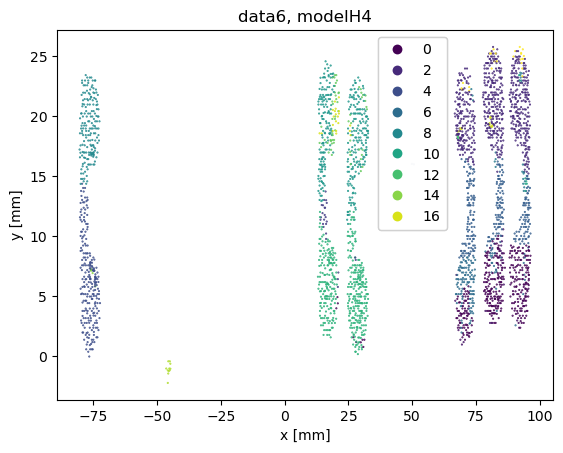

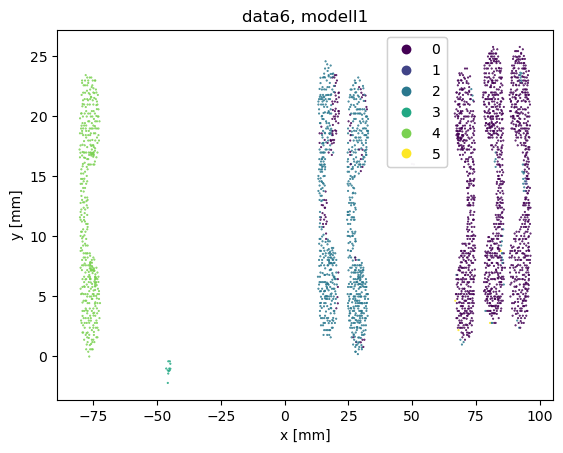

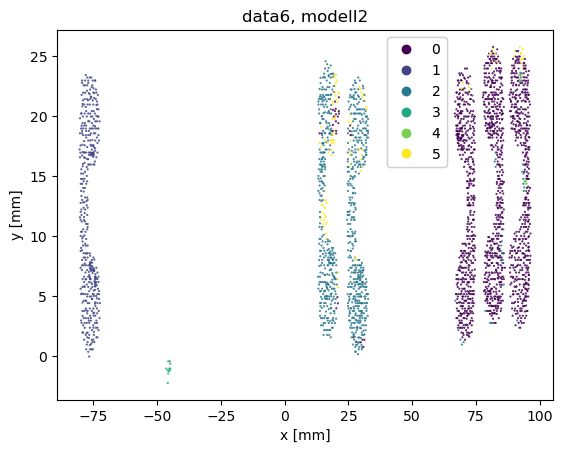

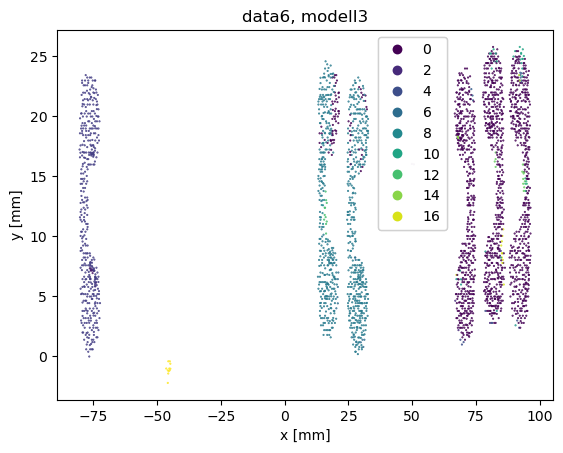

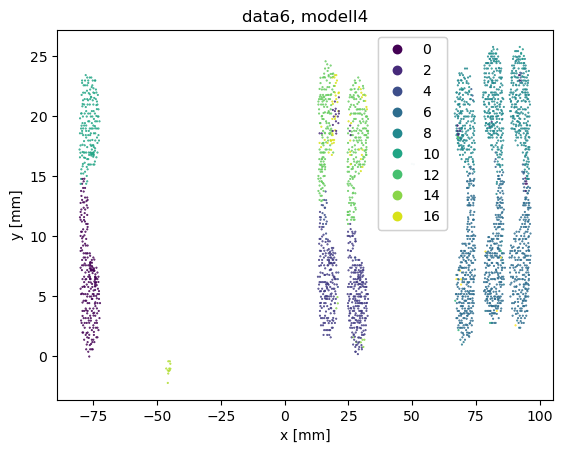

In [30]:
run_all_models(data6, "data6")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data7, modelA
val
[0 1 2 3 4 5]
val_count
[428 945 788 114 595  52]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data7, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[243 282 208  81 274  24 185 298  11   9 245 225 216 161  19 209  33 199]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning: Affinity propagation did not converge, this model may return degenerate cluster centers and labels.
  warnings.warn(


data7, modelC
val
[   0    1    2 ... 1318 1319 1320]
val_count
[1 1 1 ... 1 1 1]
data7, modelD
val
[0 1 2 3 4 5]
val_count
[791  49 428 761 114 779]
data7, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[184 442  24  81 193   9 218  11 199  35 185 214 346 176  19 205 192 189]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelF1
val
[0 1 2 3 4 5]
val_count
[1540   52  788  417   11  114]
data7, modelF2
val
[0 1 2 3 4 5]
val_count
[1540   52  788  417   11  114]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 14   6   2  24  81   3  11  19   3 442  11 346 497 498   1 417 543   4]
data7, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 14   2   6  24  11   3  81  19   4 442 497 346   3  11   1 417 543 498]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelG1
val
[0 1 2 3 4 5]
val_count
[1041  788  428  114   52  499]
data7, modelG2
val
[0 1 2 3 4 5]
val_count
[1041  788  428  114   52  499]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[237  81 279 218 212 262 315 199 183   9  33 183 163 264 230  19  24  11]
data7, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[237  81 279 218 212 262 315 199 183   9  33 183 163 264 230  19  24  11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelH1
val
[0 1 2 3 4 5]
val_count
[1654   43    9  788  417   11]
data7, modelH2
val
[0 1 2 3 4 5]
val_count
[ 428  499   52  114  788 1041]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[   6   24   19 1041    7   14   14  442   10  417   11    3   11  346
   57    2    1  497]
data7, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[ 81 346  33   9  19 407 211 231 202 369 215 223  24  11 136 129 274   2]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelI1
val
[0 1 2 3 4 5]
val_count
[1654   43    9  788  417   11]
data7, modelI2
val
[0 1 2 3 4 5]
val_count
[ 116   52  417  788 1538   11]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 7 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data7, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  14   24 1041   53  497   19   28    3  346  417    3   11    7  442
   11    1    2    3]
data7, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[442 497 417   8 543  28  53   6  14 346 235  11  24   3   2  19 263  11]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


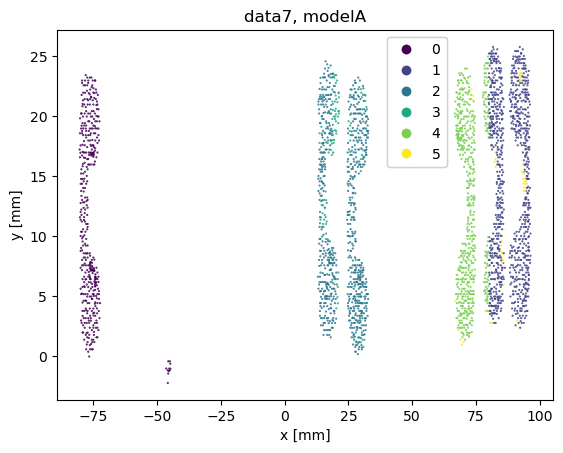

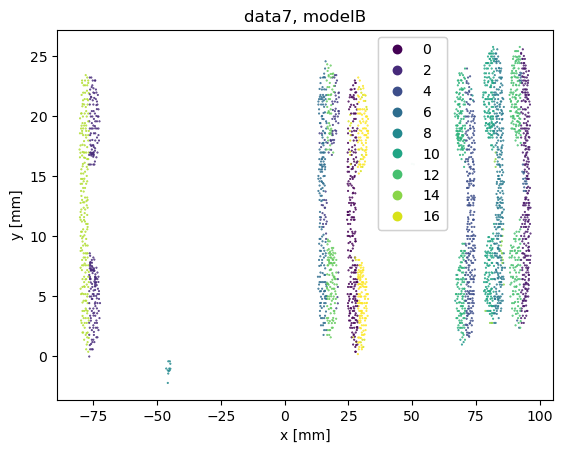

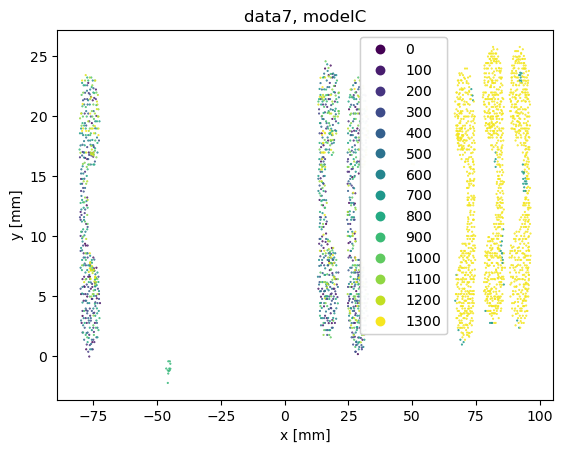

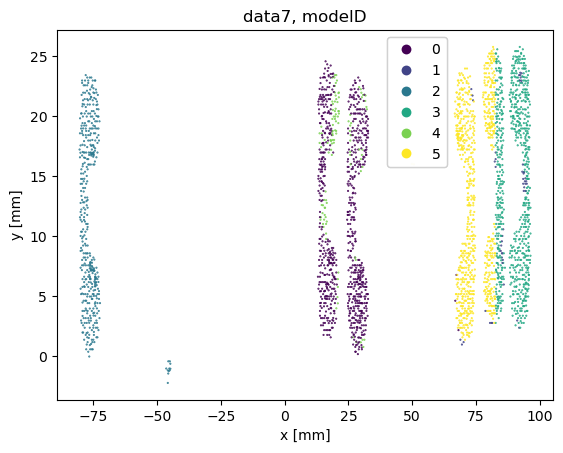

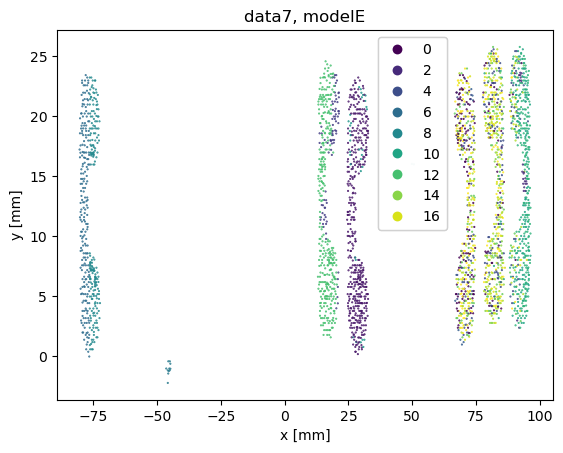

...

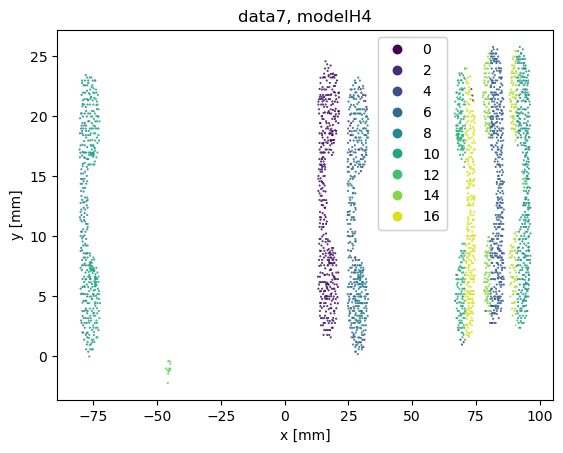

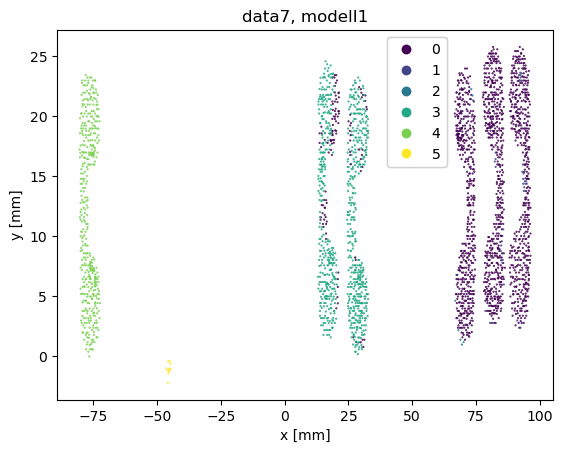

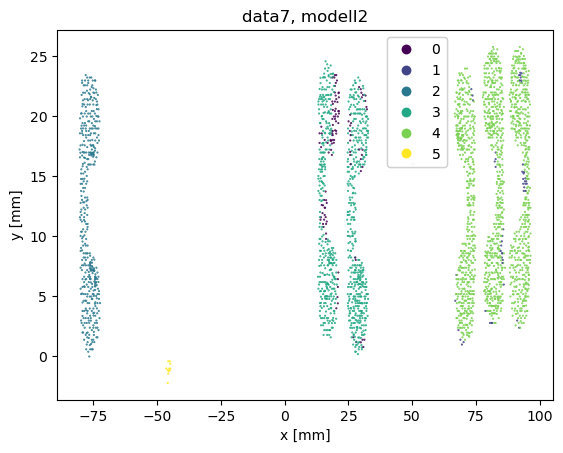

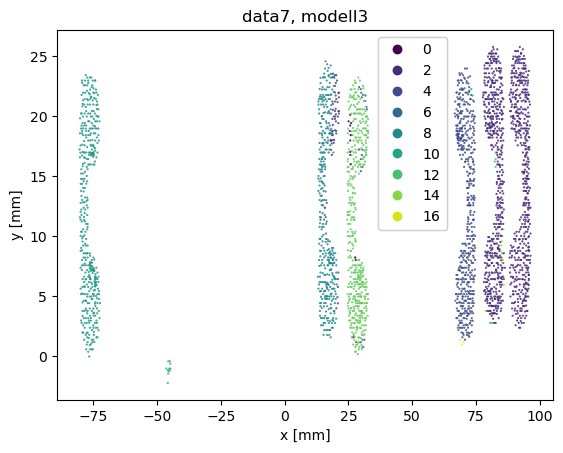

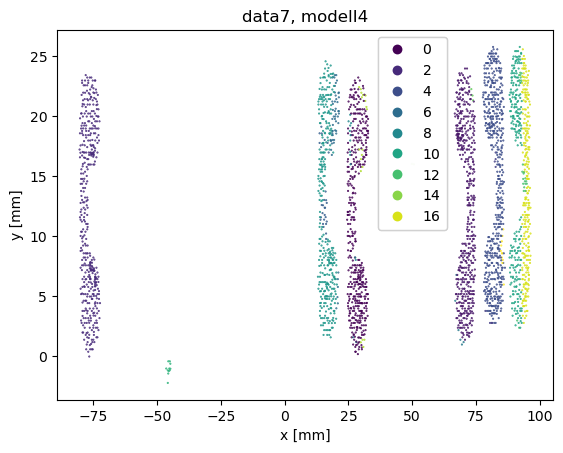

In [35]:
run_all_models(data7, "data7")

In [ ]:
run_all_models(data8, "data8")

In [ ]:
run_all_models(data9, "data9")

In [ ]:
run_all_models(data10, "data10")

C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data11, modelA
val
[0 1 2 3 4 5]
val_count
[562 428 475 522 427 508]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


data11, modelB
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[201 197 208 163 182 228  11 121 224 189 209 161 226 157   2 198 141 104]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning: Affinity propagation did not converge, this model may return degenerate cluster centers and labels.
  warnings.warn(


data11, modelC
val
[   0    1    2 ... 1328 1329 1330]
val_count
[1 1 1 ... 1 1 1]
data11, modelD
val
[0 1 2 3 4 5]
val_count
[ 522  417   11 1068  427  477]
data11, modelE
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[628  11 208 475 456   1 497 427   1   1   1   1   1   2   1 209   1   1]
data11, modelF1
val
[0 1 2 3 4 5]
val_count
[1590    2  475   11  427  417]
data11, modelF2
val
[0 1 2 3 4 5]
val_count
[1590    2   11  417  427  475]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(
C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelF3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[475 513   4   5 502 417 420   6   2   1   5   7   1   9 552   1   1   1]
data11, modelF4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[  3 417 558   5   9 420 513 474   3   1   1   7 502   1   5   1   1   1]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelG1
val
[0 1 2 3 4 5]
val_count
[428 522 562 508 427 475]
data11, modelG2
val
[0 1 2 3 4 5]
val_count
[428 522 562 508 427 475]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:282: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelG3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[244 265 241 299 168 218 146 139 248 142 136 182 199   2  11 109  89  84]
data11, modelG4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[244 265 241 299 168 218 147 139 247 142 136 182 199   2  11 109  89  84]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelH1
val
[0 1 2 3 4 5]
val_count
[ 902   11 1084  417    2  506]
data11, modelH2
val
[0 1 2 3 4 5]
val_count
[ 902 1084  506  417   11    2]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelH3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[402   2 411 502  15   5 511 558   5   8 465   4   3   1  11   1  10   8]
data11, modelH4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[215 229 277 232 217 263 202 154 138  11 128   2 129 230 192 117 130  56]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelI1
val
[0 1 2 3 4 5]
val_count
[ 902   11 1084  417    2  506]
data11, modelI2
val
[0 1 2 3 4 5]
val_count
[ 902  417 1084   11    2  506]


C:\Users\KZTYLF\Anaconda3\envs\gnn-env\lib\site-packages\sklearn\cluster\_agglomerative.py:552: UserWarning: the number of connected components of the connectivity matrix is 5 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


data11, modelI3
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[411 511  16  15 465 502 558 402  10   1   4   3   5   1  11   1   5   1]
data11, modelI4
val
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
val_count
[231 244 199 108 277 278 218  11 179   2 183 183 138 180 139  66 140 146]


C:\Users\KZTYLF\AppData\Local\Temp\ipykernel_24112\2856011846.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


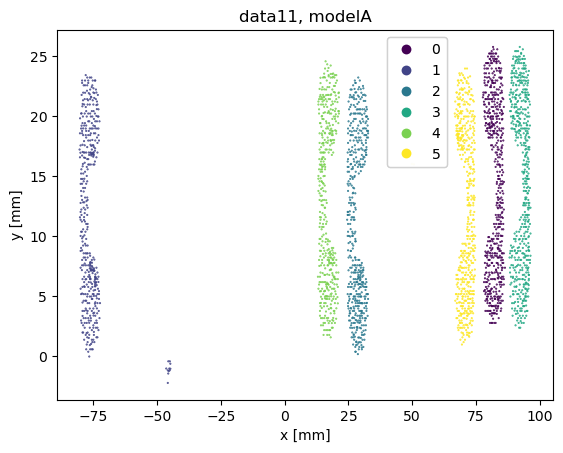

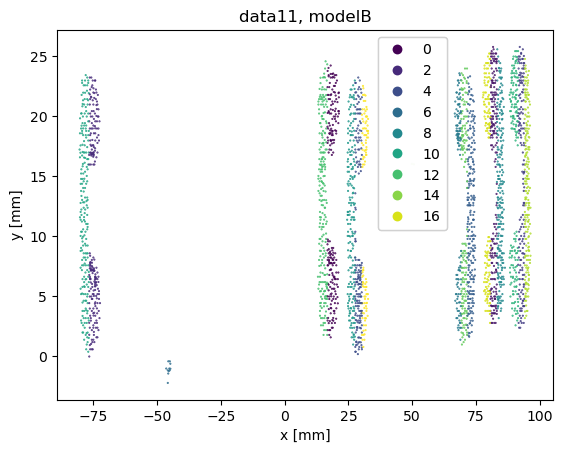

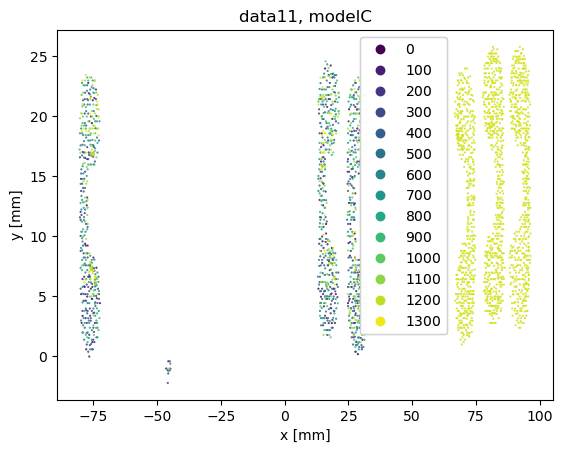

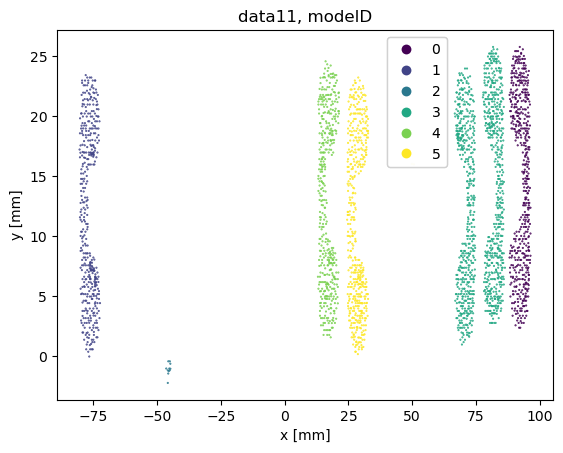

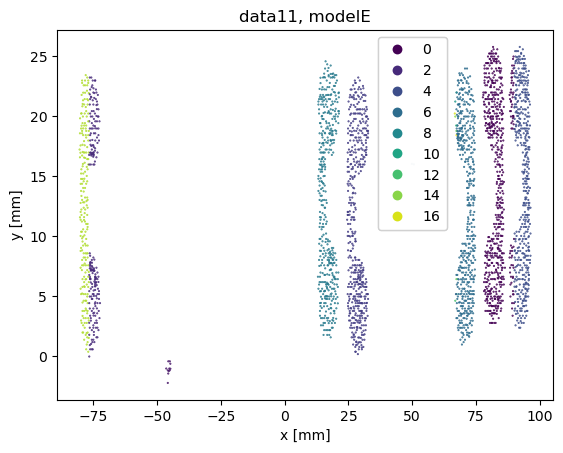

...

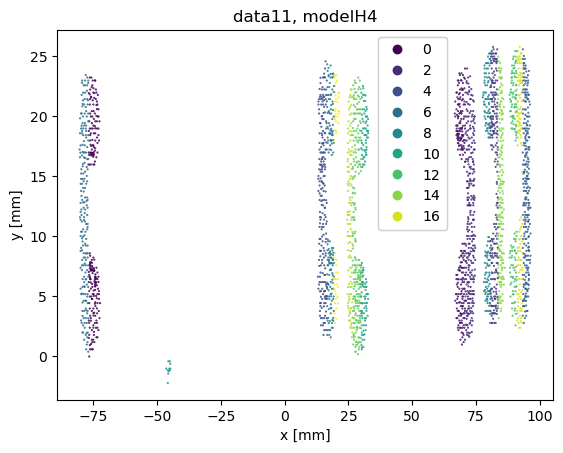

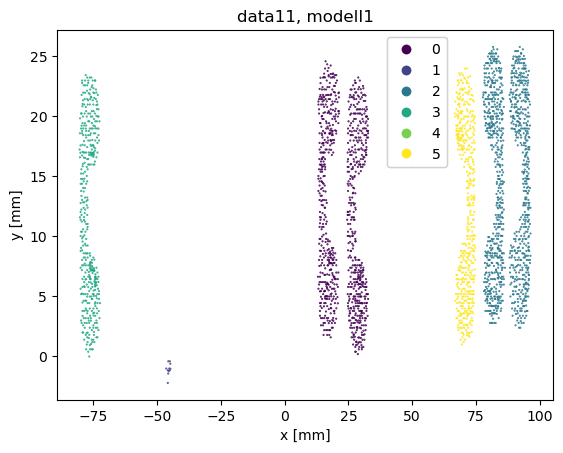

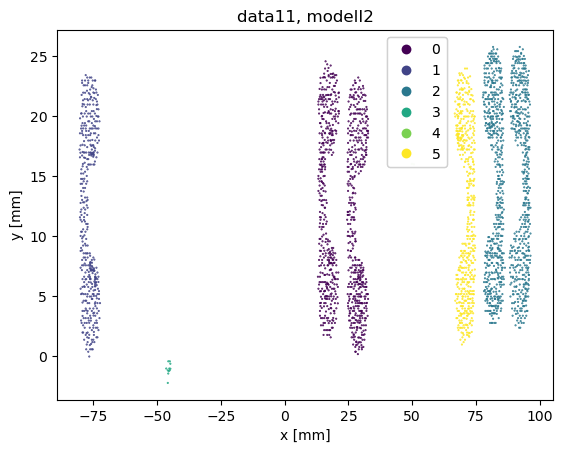

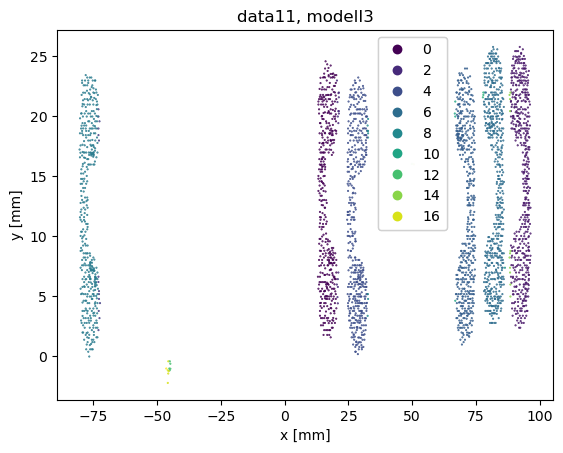

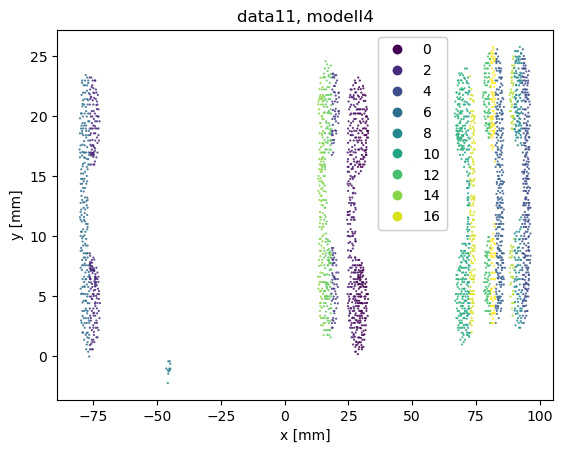

In [42]:
run_all_models(data11, "data11")

## DBSCAN Clustering
Reqs parameters: min cluster size and max distance dist btween pair to be neighbors (primary param)

NEXT: 
 - Run with diff params and Check the cluster count against the predicted cluster count
 - Look into the inner workings for algo and data efficiency guidance

[0 0 1 ... 0 4 0]
[-1  0  1  2  3  4  5]


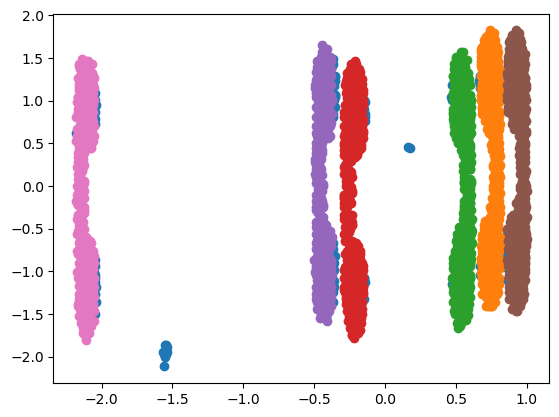

In [72]:
from sklearn.cluster import DBSCAN

# defining the model
DBSCAN_m1 = DBSCAN(eps=0.01, min_samples=50)

# # training the model
# DBSCAN_m1.fit(data1)
# DBSCAN_m1.

# assiging to cluster
DBSCAN_result = DBSCAN_m1.fit_predict(data11)
DBSCAN_clusters1 = np.unique(DBSCAN_result)

print(DBSCAN_result)
print(DBSCAN_clusters1)

# plotting
for cluster in DBSCAN_clusters1:
    idx = np.where(DBSCAN_result == cluster)
    plt.scatter(data1[idx, 0], data2[idx, 1])
    
    
plt.show()


0.45, 50
val
[-1  0  1]
val_count
[  11 2494  417]
0.40, 50
val
[-1  0  1]
val_count
[  11 2494  417]
0.35, 50
val
[-1  0  1]
val_count
[  11 2494  417]
0.30, 50
val
[-1  0  1  2]
val_count
[  12 1591  902  417]
0.25, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.20, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.15, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.10, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.09, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.08, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.07, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.06, 50
val
[-1  0  1  2]
val_count
[  13 1590  902  417]
0.05, 50
val
[-1  0  1  2  3  4]
val_count
[  13 1084  506  475  427  417]
0.04, 50
val
[-1  0  1  2  3  4]
val_count
[  13 1084  506  475  427  417]
0.03, 50
val
[-1  0  1  2  3  4  5]
val_count
[ 13 562 506 475 427 522 417]
0.02, 50
val
[-1  0  1  2  3  4  5]
val_count
[ 13 562 506 475 427 522 417]
0.01, 50
val
[

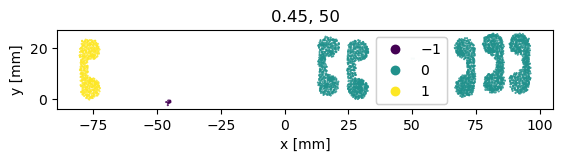

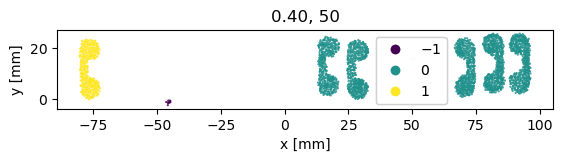

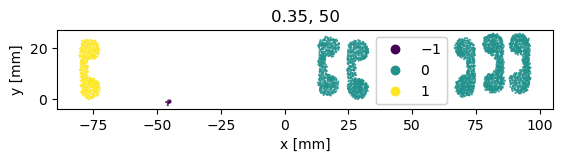

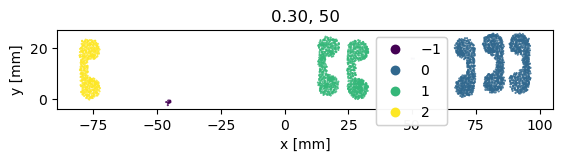

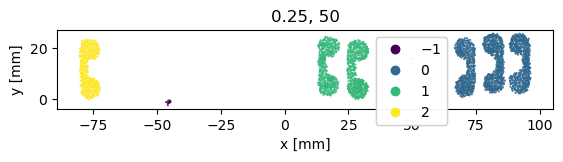

...

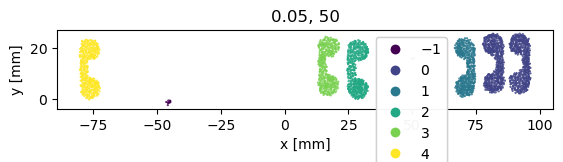

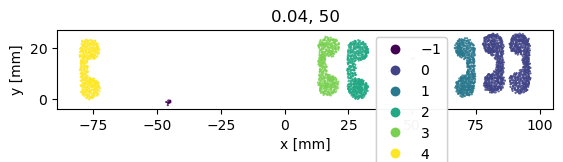

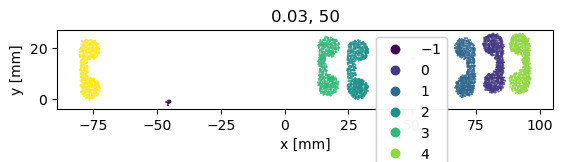

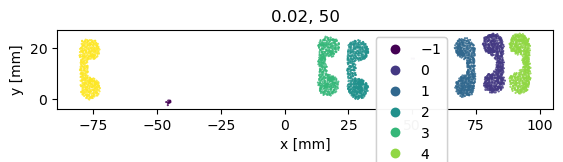

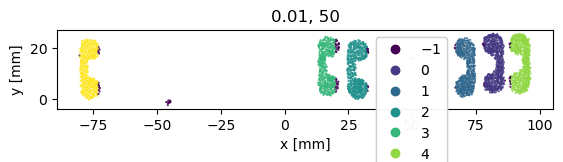

In [113]:
def DBSCAN_process(eps, min_samples, data, title=""):
    ## define mode
    model = DBSCAN(eps=eps, min_samples=min_samples)
    
    ## train and cluster
    result = model.fit_predict(data)
    result = np.expand_dims(result, axis=1)
    clusters = np.unique(result)
#     print("clusters: ")    
#     print(clusters)
    
#     print("Result:")
#     print(result.shape)
    
    ## plot
#     plt.scatter(data[:0])
#     print("non_bg")
#     print(non_bg.shape)
    
#     print('non_bg_idx')
#     print(non_bg_idx.shape)
    plot_inference(non_bg, result, title=title)

    
    
# DBSCAN_process(0.01, 60, data11)
DBSCAN_process(0.45, 50, data11, "0.45, 50")
DBSCAN_process(0.40, 50, data11, "0.40, 50")
DBSCAN_process(0.35, 50, data11, "0.35, 50")
DBSCAN_process(0.30, 50, data11, "0.30, 50")
DBSCAN_process(0.25, 50, data11, "0.25, 50")
DBSCAN_process(0.20, 50, data11, "0.20, 50")
DBSCAN_process(0.15, 50, data11, "0.15, 50")
DBSCAN_process(0.10, 50, data11, "0.10, 50")
DBSCAN_process(0.09, 50, data11, "0.09, 50")
DBSCAN_process(0.08, 50, data11, "0.08, 50")
DBSCAN_process(0.07, 50, data11, "0.07, 50")
DBSCAN_process(0.06, 50, data11, "0.06, 50")
DBSCAN_process(0.05, 50, data11, "0.05, 50")
DBSCAN_process(0.04, 50, data11, "0.04, 50")
DBSCAN_process(0.03, 50, data11, "0.03, 50")
DBSCAN_process(0.02, 50, data11, "0.02, 50")
DBSCAN_process(0.01, 50, data11, "0.01, 50")

0.45, 50
val
[-1  0  1]
val_count
[  11 2494  417]
0.40, 50
val
[-1  0  1  2]
val_count
[  11 1592  902  417]
0.35, 50
val
[-1  0  1  2  3]
val_count
[  11 1591  903  235  182]
0.30, 50
val
[-1  0  1  2  3]
val_count
[  22 1590  902  217  191]
0.25, 50
val
[-1  0  1  2  3]
val_count
[  40 1590  902  208  182]
0.20, 50
val
[-1  0  1  2  3  4]
val_count
[ 115 1590  452  392  196  177]
0.15, 50
val
[-1  0  1  2  3  4  5]
val_count
[588 673 687 412 324 126 112]


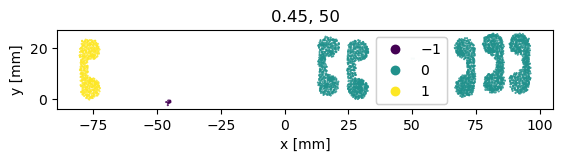

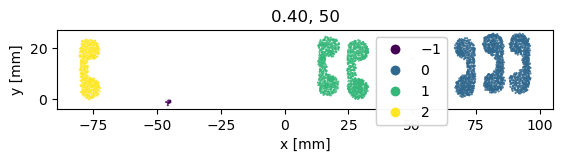

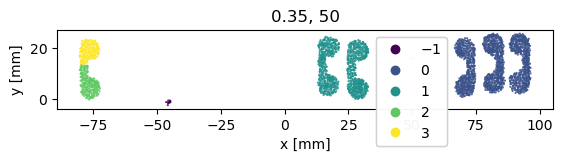

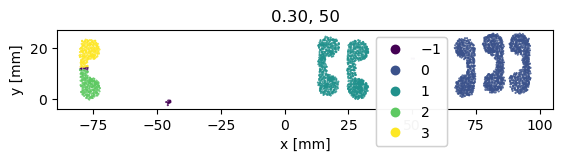

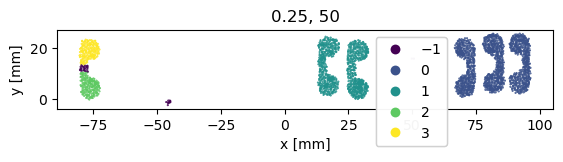

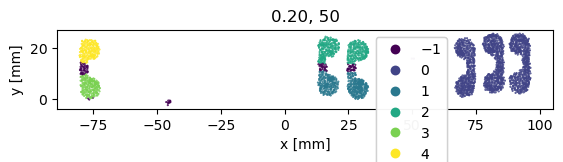

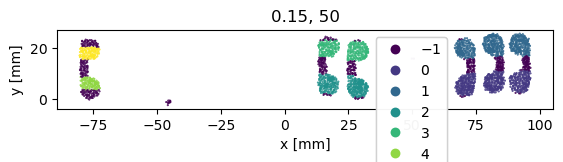

In [115]:
# DBSCAN_process(0.01, 60, data11)
DBSCAN_process(0.45, 50, data12, "0.45, 50")
DBSCAN_process(0.40, 50, data12, "0.40, 50")
DBSCAN_process(0.35, 50, data12, "0.35, 50")
DBSCAN_process(0.30, 50, data12, "0.30, 50")
DBSCAN_process(0.25, 50, data12, "0.25, 50")
DBSCAN_process(0.20, 50, data12, "0.20, 50")
DBSCAN_process(0.15, 50, data12, "0.15, 50")


## OPTICS Clustering
Params
 - min_samples
 - max_eps
 - cluster_method

OPTICS_200min_0.1-Inf
val
[-1  0  1  2  3  4  5]
val_count
[  8 600 484 506 483 413 428]
OPTICS_100min_0.2-Inf
val
[-1  0  1  2  3  4  5  6]
val_count
[1417  280  300  194  162  190  215  164]
OPTICS_300min_0.3-Inf
val
[-1  0  1  2  3  4  5]
val_count
[104 562 455 506 474 393 428]
OPTICS_150min_0.4-Inf
val
[-1  0  1  2  3  4  5]
val_count
[517 291 283 506 475 422 428]
OPTICS_250min_0.5-Inf
val
[-1  0  1  2  3  4  5]
val_count
[ 76 562 459 506 489 402 428]


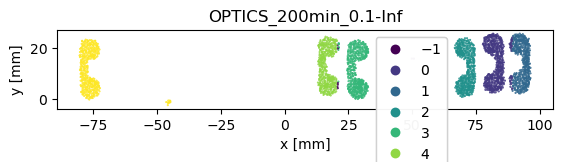

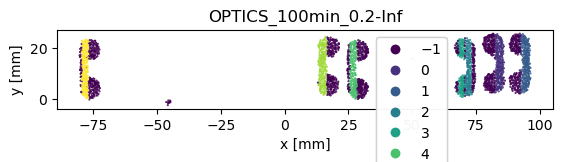

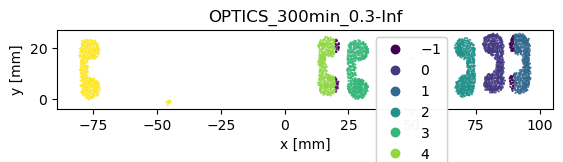

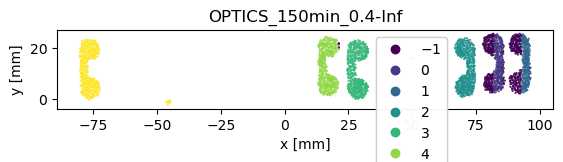

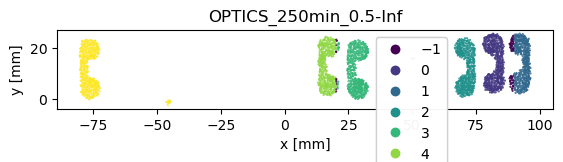

In [129]:
from sklearn.cluster import OPTICS

def OPTICS_process(min_samples, max_eps, eps, data, title=""):
    
    ## define model
    model = OPTICS(eps=eps, min_samples=min_samples, max_eps=max_eps)
    
    ## train and cluster
    result = model.fit_predict(data)
    result = np.expand_dims(result, axis=1)
    clusters = np.unique(result)
#     print("clusters: ")    
#     print(clusters)
    
#     print("Result:")
#     print(result.shape)
    
    ## plot
#     plt.scatter(data[:0])
#     print("non_bg")
#     print(non_bg.shape)
    
#     print('non_bg_idx')
#     print(non_bg_idx.shape)
    plot_inference(non_bg, result, title=title)
    
OPTICS_process(200, 1, 1, data11, title="OPTICS_200min_0.1-Inf")
OPTICS_process(100, 1, 1, data11, title="OPTICS_100min_0.2-Inf")
OPTICS_process(300, 1, 1, data11, title="OPTICS_300min_0.3-Inf")
OPTICS_process(150, 1, 1, data11, title="OPTICS_150min_0.4-Inf")
OPTICS_process(250, 1, 1, data11, title="OPTICS_250min_0.5-Inf")